In [86]:
import numpy as np
import pandas as pd
import os
from numpy import argmax
from pickle import load
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
from keras.models import model_from_json
from nltk.translate.bleu_score import corpus_bleu, sentence_bleu

In [2]:
def load_model(filename, verbose=False):
    json_file = open(filename + '.json', 'r')
    loaded_model_json = json_file.read()
    json_file.close()
    loaded_model = model_from_json(loaded_model_json)
    loaded_model.load_weights(filename + ".h5")
    if verbose:
        print("The following model " + filename + " has been loaded")
    return loaded_model

In [3]:
def load_doc(filename):
    file = open(filename, 'r')
    text = file.read()
    file.close()
    return text

In [4]:
def load_set(filename):
    doc = load_doc(filename)
    dataset = list()
    for line in doc.split('\n'):
        if len(line) < 1:
            continue
        identifier = line.split('.')[0]
        dataset.append(identifier)
    return set(dataset)

In [5]:
def load_clean_descriptions(filename, dataset):
    doc = load_doc(filename)
    descriptions = dict()
    for line in doc.split('\n'):
        tokens = line.split()
        image_id, image_desc = tokens[0], tokens[1:]
        if image_id in dataset:
            if image_id not in descriptions:
                descriptions[image_id] = list()
            desc = 'startseq ' + ' '.join(image_desc) + ' endseq'
            descriptions[image_id].append(desc)
    return descriptions

In [6]:
def load_photo_features(filename, dataset):
    all_features = load(open(filename, 'rb'))
    features = {k: all_features[k] for k in dataset}
    return features

In [7]:
def to_lines(descriptions):
    all_desc = list()
    for key in descriptions.keys():
        [all_desc.append(d) for d in descriptions[key]]
    return all_desc

In [8]:
def create_tokenizer(descriptions):
    lines = to_lines(descriptions)
    tokenizer = Tokenizer()
    tokenizer.fit_on_texts(lines)
    return tokenizer

In [9]:
def max_length(descriptions):
    lines = to_lines(descriptions)
    return max(len(d.split()) for d in lines)

In [10]:
def word_for_id(integer, tokenizer):
    for word, index in tokenizer.word_index.items():
        if index == integer:
            return word
    return None

In [11]:
def generate_desc(model, tokenizer, photo, max_length):
    in_text = 'startseq'
    for i in range(max_length):
        sequence = tokenizer.texts_to_sequences([in_text])[0]
        sequence = pad_sequences([sequence], maxlen=max_length)
        yhat = model.predict([photo,sequence], verbose=0)
        yhat = argmax(yhat)
        word = word_for_id(yhat, tokenizer)
        if word is None:
            break
        in_text += ' ' + word
        if word == 'endseq':
            break
    return in_text

In [12]:
def evaluate_model(model, descriptions, photos, tokenizer, max_length):
    actual, predicted = list(), list()
    for key, desc_list in descriptions.items():
        yhat = generate_desc(model, tokenizer, photos[key], max_length)
        references = [d.split() for d in desc_list]
        actual.append(references)
        predicted.append(yhat.split())
    print('BLEU-1: %f' % corpus_bleu(actual, predicted, weights=(1.0, 0, 0, 0)))
    print('BLEU-2: %f' % corpus_bleu(actual, predicted, weights=(0.5, 0.5, 0, 0)))
    print('BLEU-3: %f' % corpus_bleu(actual, predicted, weights=(0.3, 0.3, 0.3, 0)))
    print('BLEU-4: %f' % corpus_bleu(actual, predicted, weights=(0.25, 0.25, 0.25, 0.25)))

## Prepare train set

In [13]:
train_filename = '../../datasets/flickr8k/Flickr8k_text/Flickr_8k.trainImages.txt'
train = load_set(train_filename)
print('Dataset: %d' % len(train))

Dataset: 6000


In [14]:
train_descriptions = load_clean_descriptions('descriptions.txt', train)
print('Descriptions: train=%d' % len(train_descriptions))

Descriptions: train=6000


In [15]:
tokenizer = create_tokenizer(train_descriptions)
vocab_size = len(tokenizer.word_index) + 1
print('Vocabulary Size: %d' % vocab_size)

Vocabulary Size: 7579


In [16]:
max_length = max_length(train_descriptions)
print('Description Length: %d' % max_length)

Description Length: 34


## Prepare test set

In [17]:
test_filename = '../../datasets/flickr8k/Flickr8k_text/Flickr_8k.testImages.txt'
test = load_set(test_filename)
print('Dataset: %d' % len(test))

Dataset: 1000


In [18]:
test_descriptions = load_clean_descriptions('descriptions.txt', test)
print('Descriptions: test=%d' % len(test_descriptions))

Descriptions: test=1000


In [19]:
#change features.pkl in case of using inceptionV3 
test_features = load_photo_features('features.pkl', test)
print('Photos: test=%d' % len(test_features))

Photos: test=1000


# Evaluate model

In [58]:
model_filename = './model_weights/model_lstm_end_5'
model = load_model(model_filename)

In [59]:
evaluate_model(model, test_descriptions, test_features, tokenizer, max_length)

BLEU-1: 0.567917
BLEU-2: 0.327101
BLEU-3: 0.230917
BLEU-4: 0.112000


In [61]:
# model_lstm_end_5
# BLEU-1: 0.567917
# BLEU-2: 0.327101
# BLEU-3: 0.230917
# BLEU-4: 0.112000

In [57]:
# model_lstm_end_3
# BLEU-1: 0.576892
# BLEU-2: 0.330481
# BLEU-3: 0.235706
# BLEU-4: 0.118113

In [ ]:
# model_lstm_end_0
# BLEU-1: 0.589627
# BLEU-2: 0.338072
# BLEU-3: 0.232253
# BLEU-4: 0.109980

In [32]:
# model_lstm_2_9
# BLEU-1: 0.550192
# BLEU-2: 0.308358
# BLEU-3: 0.217599
# BLEU-4: 0.107457

In [28]:
# model_lstm_2_5
# BLEU-1: 0.543121
# BLEU-2: 0.301569
# BLEU-3: 0.209945
# BLEU-4: 0.099759

In [ ]:
# model_lstm_2_3
# BLEU-1: 0.562641
# BLEU-2: 0.318167
# BLEU-3: 0.222843
# BLEU-4: 0.107840

In [ ]:
# model_concat_9
# BLEU-1: 0.474946
# BLEU-2: 0.220720
# BLEU-3: 0.138319
# BLEU-4: 0.054092

In [ ]:
# model_concat_5
# BLEU-1: 0.555860
# BLEU-2: 0.279278
# BLEU-3: 0.180292
# BLEU-4: 0.077575

In [ ]:
# model_concat_3
# BLEU-1: 0.552638
# BLEU-2: 0.289466
# BLEU-3: 0.186328
# BLEU-4: 0.080312

In [ ]:
# model_3
# BLEU-1: 0.578345
# BLEU-2: 0.325348
# BLEU-3: 0.226961
# BLEU-4: 0.111016

In [ ]:
# model_5
# BLEU-1: 0.569996
# BLEU-2: 0.319198
# BLEU-3: 0.222908
# BLEU-4: 0.110318

In [ ]:
# model_9
# BLEU-1: 0.547792
# BLEU-2: 0.302444
# BLEU-3: 0.209226
# BLEU-4: 0.102418

In [ ]:
# model_11
# BLEU-1: 0.535853
# BLEU-2: 0.287559
# BLEU-3: 0.199070
# BLEU-4: 0.097181

In [ ]:
# # photo features
# test_features = load_photo_features('../input/flirck-8k-dataset-explore-image-resnet/features.pkl', test)
# print('Resnet\nPhotos: test=%d' % len(test_features))

# # load the model
# filename = '../input/development-model-resnet50/model_19.h5'
# model = load_model(filename)
# # evaluate model
# evaluate_model(model, test_descriptions, test_features, tokenizer, max_length)

### Evaluate model - lemmatize

In [52]:
import nltk
from nltk.corpus import wordnet
from nltk import WordNetLemmatizer
def get_wordnet_pos(word):
    """Map POS tag to first character lemmatize() accepts"""
    tag = nltk.pos_tag([word])[0][1][0].upper()
    tag_dict = {"J": wordnet.ADJ,
                "N": wordnet.NOUN,
                "V": wordnet.VERB,
                "R": wordnet.ADV}

    return tag_dict.get(tag, wordnet.NOUN)

def lemmatize_sentense(sentence):
    lemmatizer = WordNetLemmatizer()
    return [lemmatizer.lemmatize(w, get_wordnet_pos(w)) for w in nltk.word_tokenize(sentence)]

In [53]:
def evaluate_model_lemmatized(model, descriptions, photos, tokenizer, max_length):
    actual, predicted = list(), list()
    for key, desc_list in descriptions.items():
        yhat = generate_desc(model, tokenizer, photos[key], max_length)
        references = [d.split() for d in desc_list]
        actual.append([lemmatize_sentense(' '.join(lst)) for lst in asd])
        predicted.append(lemmatize_sentense(' '.join(yaht)))
    print('BLEU-1: %f' % corpus_bleu(actual, predicted, weights=(1.0, 0, 0, 0)))
    print('BLEU-2: %f' % corpus_bleu(actual, predicted, weights=(0.5, 0.5, 0, 0)))
    print('BLEU-3: %f' % corpus_bleu(actual, predicted, weights=(0.3, 0.3, 0.3, 0)))
    print('BLEU-4: %f' % corpus_bleu(actual, predicted, weights=(0.25, 0.25, 0.25, 0.25)))

In [54]:
evaluate_model_lemmatized(model, test_descriptions, test_features, tokenizer, max_length)

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/nltk/translate/bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


BLEU-1: 0.727273
BLEU-2: 0.467099
BLEU-3: 0.403350
BLEU-4: 0.000000


## Evaluate model on one image

In [107]:
import matplotlib.pyplot as plt
def plot_image(filename):
    x=plt.imread(filename)
    plt.imshow(x)
    plt.show()

In [108]:
def print_references(references):
    refs = [' '.join(elem)[9:-7] for elem in references]
    for ref in refs:
        print("Reference: ", ref)

In [109]:
def calculate_bleu_score(references, candidate):
    cand = candidate[1:-1]
    refs = [re[1:-1] for re in references]
    print("Bleu_1 score: ",sentence_bleu(refs,cand, weights=(1.0, 0, 0, 0)))
    print("Bleu_2 score: ",sentence_bleu(refs,cand, weights=(0.5, 0.5, 0, 0)))
    print("Bleu_3 score: ",sentence_bleu(refs,cand, weights=(0.3, 0.3, 0.3, 0)))
    print("Bleu_4 score: ",sentence_bleu(refs,cand, weights=(0.25, 0.25, 0.25, 0.25)))


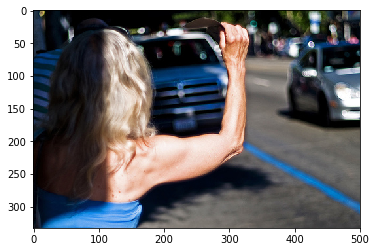

Candidate:  man in black shirt is sitting on bench 
Reference:  blond woman in blue shirt appears to wait for ride
Reference:  blond woman is on the street hailing taxi
Reference:  woman is signaling is to traffic as seen from behind
Reference:  woman with blonde hair wearing blue tube top is waving on the side of the street
Reference:  the woman in the blue dress is holding out her arm at oncoming traffic
Bleu_1 score:  0.5
Bleu_2 score:  1.0547686614863434e-154
Bleu_3 score:  2.0801644027471386e-185
Bleu_4 score:  1.5319719891192393e-231


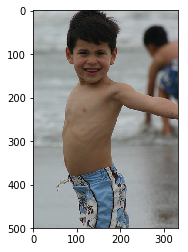

Candidate:  boy in red swimsuit is jumping into the water 
Reference:  boy in his blue swim shorts at the beach
Reference:  boy smiles for the camera at beach
Reference:  young boy in swimming trunks is walking with his arms outstretched on the beach
Reference:  children playing on the beach
Reference:  the boy is playing on the shore of an ocean
Bleu_1 score:  0.4444444444444444
Bleu_2 score:  0.23570226039551587
Bleu_3 score:  2.1262855015914924e-93
Bleu_4 score:  7.241926111174567e-155


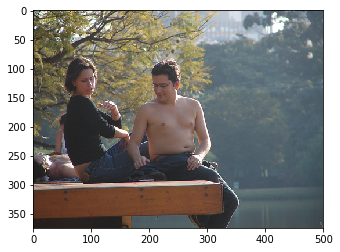

Candidate:  man in black shirt is sitting on the edge of fountain 
Reference:  lady and man with no shirt sit on dock
Reference:  man and woman are sitting on dock together
Reference:  man and woman sitting on dock
Reference:  man and woman sitting on deck next to lake
Reference:  shirtless man and woman sitting on dock
Bleu_1 score:  0.36363636363636365
Bleu_2 score:  0.19069251784911848
Bleu_3 score:  1.8724210775784562e-93
Bleu_4 score:  6.513869329968086e-155


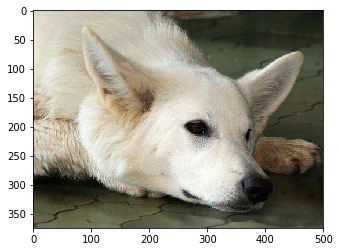

Candidate:  brown dog is playing with stick 
Reference:  closeup of white dog that is laying its head on its paws
Reference:  large white dog lying on the floor
Reference:  white dog has its head on the ground
Reference:  white dog is resting its head on tiled floor with its eyes open
Reference:  white dog rests its head on the patio bricks
Bleu_1 score:  0.423240862445307
Bleu_2 score:  0.2676810248362385
Bleu_3 score:  2.146944984485809e-93
Bleu_4 score:  7.100514228897259e-155


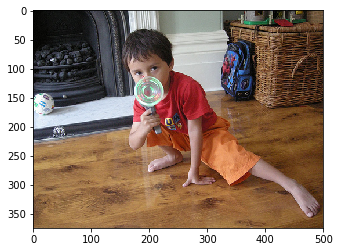

Candidate:  young boy in pink shirt is playing with toy 
Reference:  boy with toy gun
Reference:  little boy in orange shorts playing with toy
Reference:  young boy with his foot outstretched aims toy at the camera in front of fireplace
Reference:  young child plays with his new lightup toy
Reference:  boy with toy gun pointed at the camera
Bleu_1 score:  0.6666666666666666
Bleu_2 score:  0.5773502691896257
Bleu_3 score:  0.4011753235797363
Bleu_4 score:  5.705336763108155e-78


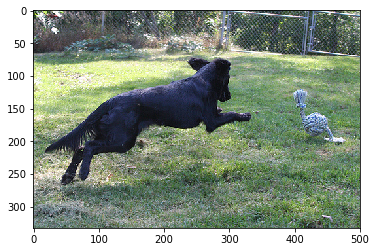

Candidate:  black dog is running through the grass 
Reference:  black dog jumping to catch rope toy
Reference:  black dog playing fetch with ball of rope
Reference:  black dog pounces to get rope toy
Reference:  black dog running after his rope toy
Reference:  large black dog is playing in grassy yard
Bleu_1 score:  0.5714285714285714
Bleu_2 score:  0.4364357804719847
Bleu_3 score:  0.37519859868268624
Bleu_4 score:  5.395774370246974e-78


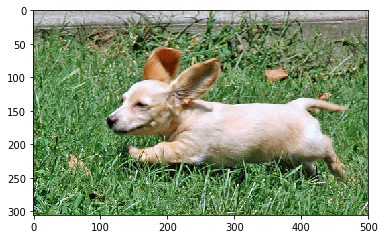

Candidate:  brown dog is running through the grass 
Reference:  little tan dog with large ears running through the grass
Reference:  playful dog is running through the grass
Reference:  small dogs ears stick up as it runs in the grass
Reference:  the small dog is running across the lawn
Reference:  this is small beige dog running through grassy field
Bleu_1 score:  0.8571428571428571
Bleu_2 score:  0.8451542547285166
Bleu_3 score:  0.8454512788430708
Bleu_4 score:  0.8091067115702212


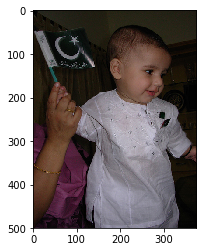

Candidate:  young boy in red shirt is eating 
Reference:  baby in white garment holds flag with crescent moon and star
Reference:  baby is holding small black flag with moon and star on it
Reference:  baby wearing white gown waves muslim flag
Reference:  little toddler dressed in white is smiling while lady helps him wave flag
Reference:  baby in white outfit holding black and white flag
Bleu_1 score:  0.2857142857142857
Bleu_2 score:  7.973301625706314e-155
Bleu_3 score:  1.7586776545063733e-185
Bleu_4 score:  1.331960397810445e-231


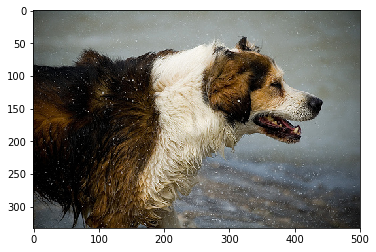

Candidate:  black dog is running through water 
Reference:  brown and white dog stands outside while it snows
Reference:  dog is looking at something near the water
Reference:  furry dog attempts to dry itself by shaking the water off its coat
Reference:  white and brown dog shaking its self dry
Reference:  the large brown and white dog shakes off water
Bleu_1 score:  0.35826565528689464
Bleu_2 score:  0.2265870956238665
Bleu_3 score:  1.8173496937128004e-93
Bleu_4 score:  6.010455532087301e-155


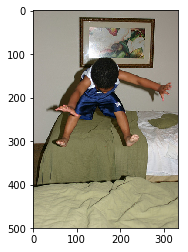

Candidate:  young boy is sleeping on bed 
Reference:  boy is jumping on bed
Reference:  boy jumped up from the green bed
Reference:  boy jumps from one bed to another
Reference:  small child is jumping on bed
Reference:  the boy in blue shorts is bouncing on the bed
Bleu_1 score:  0.6666666666666666
Bleu_2 score:  0.5163977794943222
Bleu_3 score:  3.404034469286905e-93
Bleu_4 score:  1.0719249972567852e-154


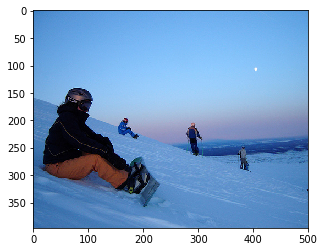

Candidate:  man in red shirt is climbing up cliff 
Reference:  snowboarder sits on slope with skiers and boarders nearby
Reference:  snowboarder takes rest on the mountainside
Reference:  snowboarders sitting in the snow while skiers take the hill
Reference:  the snowboarder is sitting down
Reference:  two skiers stand two sit on slopes
Bleu_1 score:  0.25
Bleu_2 score:  7.458340731200295e-155
Bleu_3 score:  1.6896185209462903e-185
Bleu_4 score:  1.2882297539194154e-231


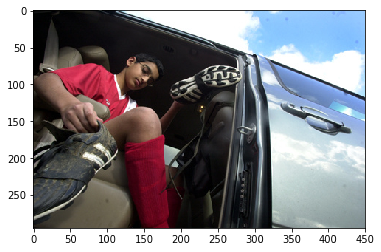

Candidate:  man in black shirt is sitting on the sidewalk 
Reference:  boy dressed in soccer attire and holding his shoes getting out of car
Reference:  boy in red soccer strip is holding his boots in his hand whilst stepping out of car
Reference:  boy in glasses is wearing red shirt
Reference:  child getting out of the car wearing soccer shoes
Reference:  young boy gets out of the van and prepares his shoes for wear during soccer game
Bleu_1 score:  0.4444444444444444
Bleu_2 score:  9.94445430826712e-155
Bleu_3 score:  2.0079454189758342e-185
Bleu_4 score:  1.4875195904069663e-231


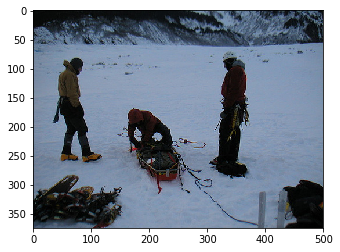

Candidate:  group of people are playing in the snow 
Reference:  three men are setting up sledge on snowy plain
Reference:  three men loading items on sled
Reference:  three people and sled
Reference:  three people are standing in the snow preparing an ice fishing boat
Reference:  three people in the snow put their gear in order
Bleu_1 score:  0.5515605641153721
Bleu_2 score:  0.45673553902495045
Bleu_3 score:  0.3472472253757243
Bleu_4 score:  4.954356947008765e-78


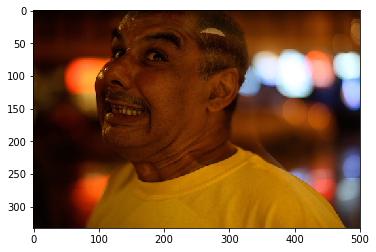

Candidate:  man in black shirt is holding drink 
Reference:  man in yellow grimaces
Reference:  man wearing yellow shirt with dramatic look on his face
Reference:  the man in the yellow tshirt is pulling large grin on his face
Reference:  there is man wearing yellow shirt and grimacing
Reference:  this man is smiling very big at the camera
Bleu_1 score:  0.4953587998572467
Bleu_2 score:  0.267524327879111
Bleu_3 score:  2.1667283753546873e-93
Bleu_4 score:  7.183445846156676e-155


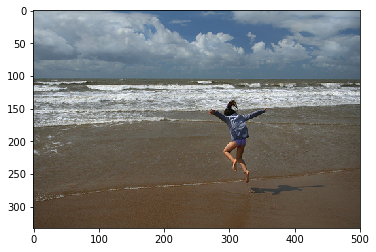

Candidate:  man is walking through the water 
Reference:  girl in blue is jumping on the shore as small waves approach her
Reference:  girl leaps into the air while standing by the ocean
Reference:  young longhaired girl on the beach is jumping in the air
Reference:  the girl is running into the ocean from the shore
Reference:  the girls is jumping into the air on the beach
Bleu_1 score:  0.17113903967753066
Bleu_2 score:  4.421625271317475e-155
Bleu_3 score:  9.45672212180377e-186
Bleu_4 score:  7.107197028258987e-232


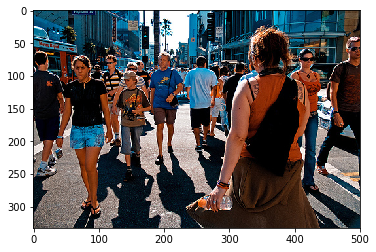

Candidate:  group of people are standing in front of the ocean 
Reference:  crowd of people walk down busy sidewalk
Reference:  group of different people are walking in all different directions in city
Reference:  group of people walking city street in warm weather
Reference:  busy intersection in the summer time in city
Reference:  people in summer clothes are walking on the sidewalk of large city
Bleu_1 score:  0.6
Bleu_2 score:  0.4472135954999579
Bleu_3 score:  0.33066025977478425
Bleu_4 score:  4.856474469839072e-78


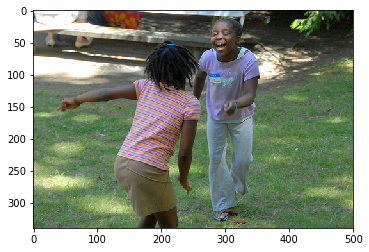

Candidate:  two girls play in the air 
Reference:  two children are laughing in the grass
Reference:  two girls laughing outside in yard
Reference:  two girls standing on grass face each other
Reference:  two young girls are playing and laughing in green grassy yard
Reference:  two young girls playing together
Bleu_1 score:  0.6666666666666666
Bleu_2 score:  0.5163977794943222
Bleu_3 score:  3.404034469286905e-93
Bleu_4 score:  1.0719249972567852e-154


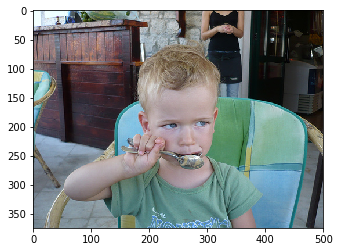

Candidate:  young boy in pretend bed 
Reference:  boy eats with spoon
Reference:  little boy holds spoon up to his mouth
Reference:  little boy is eating his food off of spoon while sitting on patio
Reference:  small child dressed in green is eating with spoon
Reference:  young child holds spoon to its mouth while sitting in chair
Bleu_1 score:  0.6
Bleu_2 score:  1.155441177691175e-154
Bleu_3 score:  2.1971111798180458e-185
Bleu_4 score:  1.6034157163765524e-231


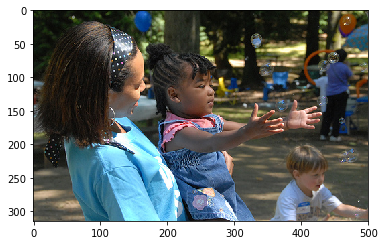

Candidate:  two girls are playing with toys 
Reference:  lady holds little girl who is trying to catch bubbles
Reference:  woman is holding little girl who is trying to catch bubbles
Reference:  woman with holding young girl playing with bubbles at picnic
Reference:  young woman in blue shirt stands holding young girl in denim dress
Reference:  there is woman holding her baby daughter while the daughter claps
Bleu_1 score:  0.17113903967753066
Bleu_2 score:  0.13256373011140135
Bleu_3 score:  1.1530451067989366e-93
Bleu_4 score:  3.891524296988902e-155


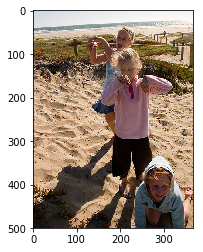

Candidate:  little girl in pink shirt is running on the beach 
Reference:  three children are playing in sand near to the beach
Reference:  three children playing in sand at beach
Reference:  three girls play in the sand
Reference:  three little blond girls two in blue one in pink play on sunny beach
Reference:  three young girls dance on the beach in the sand
Bleu_1 score:  0.6
Bleu_2 score:  0.4472135954999579
Bleu_3 score:  0.33066025977478425
Bleu_4 score:  4.856474469839072e-78


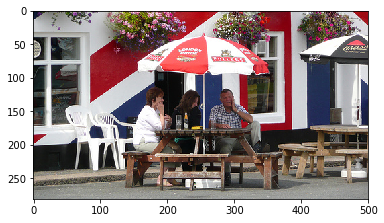

Candidate:  man is sitting on the sidewalk with his umbrella in his hand 
Reference:  couple of people sit outdoors at table with an umbrella and talk
Reference:  three people are sitting at an outside picnic bench with an umbrella
Reference:  three people sit at an outdoor cafe
Reference:  three people sit at an outdoor table in front of building painted like the union jack
Reference:  three people sit at picnic table outside of building painted like union jack
Bleu_1 score:  0.4166666666666667
Bleu_2 score:  9.628676480759687e-155
Bleu_3 score:  1.96944241247487e-185
Bleu_4 score:  1.4637115948630222e-231


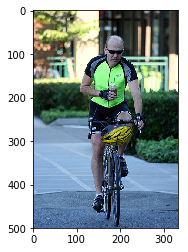

Candidate:  man in black shirt is riding bicycle down the street 
Reference:  biker enjoys coffee
Reference:  man in bright green shirt and sunglasses is riding bicycle through the streets whilst drinking latte
Reference:  man in bright green shirt riding bicycle in paved courtyard carying drink
Reference:  man rides on his bike with one hand and holds drink with the other
Reference:  man riding bike wearing green shirt with drink in his hand
Bleu_1 score:  0.6333861926251716
Bleu_2 score:  0.43707799729361313
Bleu_3 score:  0.3133549729119345
Bleu_4 score:  4.566972108023278e-78


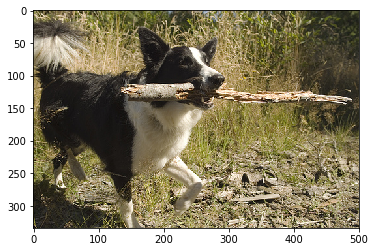

Candidate:  two dogs play with each other 
Reference:  black and white dog carrying large stick
Reference:  black and white dog is carrying stick in its mouth
Reference:  black and white dog walking through the grass with long stick in his mouth
Reference:  dog holds stick in its mouth
Reference:  dog trots across the ground with large stick in his mouth
Bleu_1 score:  0.16666666666666669
Bleu_2 score:  6.08970970641905e-155
Bleu_3 score:  1.4961022763680928e-185
Bleu_4 score:  1.1640469867513693e-231


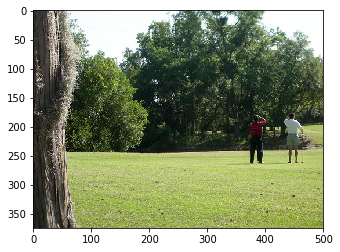

Candidate:  two girls are playing in the woods 
Reference:  one man in red shirt and black pants with man in white shirt and tan shorts golfing
Reference:  tree in the foreground two men playing golf in the background
Reference:  two golfers are standing on the fairway looking off into the distance
Reference:  two golfers look off into the distance with hands blocking the sun
Reference:  two men looking into the distance on golf course
Bleu_1 score:  0.5367694950537757
Bleu_2 score:  0.2592842992895377
Bleu_3 score:  2.008331527017773e-93
Bleu_4 score:  6.58443108435194e-155


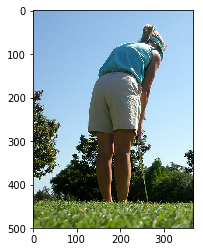

Candidate:  young boy in pink shirt is jumping into the air 
Reference:  girl is getting ready to swing the club
Reference:  woman in shorts and blue sleeveless shirt leans over golf club
Reference:  woman is taking swing with golf club
Reference:  woman wearing blue shirt and hat with khaki shorts plays golf
Reference:  woman wearing blue begins golf swing
Bleu_1 score:  0.36193496721438384
Bleu_2 score:  8.536360807345964e-155
Bleu_3 score:  1.760334530221513e-185
Bleu_4 score:  1.3109733799909448e-231


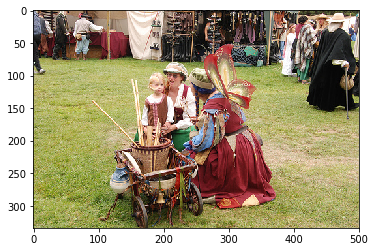

Candidate:  group of children are playing with their arms in the street 
Reference:  group of people in costume at renaissance fair
Reference:  people in costume at renaissance fair
Reference:  two woman in colorful costumes look at little girl wearing brown vest
Reference:  two women and child are sitting by cart of arrows in front of booth at medieval fayre
Reference:  two women crouch near small child at medieval fair
Bleu_1 score:  0.3320366241026409
Bleu_2 score:  0.1741214746376982
Bleu_3 score:  1.709709027118894e-93
Bleu_4 score:  5.94781875096292e-155


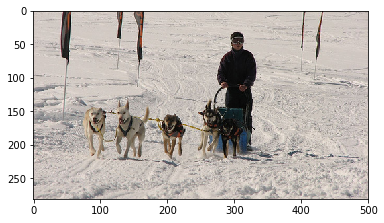

Candidate:  group of people are playing in the snow 
Reference:  group of dogs pull person on dog sled up hill
Reference:  dogsled rider pulled past flags on snowy hill
Reference:  dogs pulling sled in sled race
Reference:  five sled dogs are pulling person on sled through the snow
Reference:  the man is mushing his dogs on snow trail
Bleu_1 score:  0.75
Bleu_2 score:  0.46291004988627577
Bleu_3 score:  3.18787508243652e-93
Bleu_4 score:  1.0148936155293581e-154


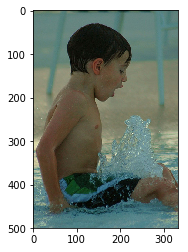

Candidate:  boy in swimming pool 
Reference:  boy sitting in water
Reference:  small boy is sitting in the water and water is splashing up through his legs
Reference:  young boy in swimming suit sits in water
Reference:  young boy sitting on water jet in pool
Reference:  little boy sitting in water with fountain coming up through his lap
Bleu_1 score:  1.0
Bleu_2 score:  0.816496580927726
Bleu_3 score:  0.7192230933248643
Bleu_4 score:  9.280167055464391e-78


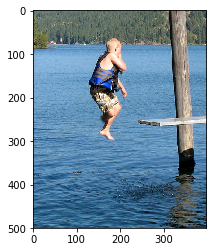

Candidate:  man in black wetsuit is canoeing in the ocean 
Reference:  blonde boy wearing blue life vest and camo shorts jumps off diveboard into blue lake
Reference:  boy diving backward off pier in large lake
Reference:  boy in blue life jacket jumps into the water
Reference:  boy in blue life jacket jumps off board into the lake
Reference:  boy is holding his nose and jumping off diving board backwards into lake
Bleu_1 score:  0.3333333333333333
Bleu_2 score:  8.612150057732663e-155
Bleu_3 score:  1.8419179593432007e-185
Bleu_4 score:  1.384292958842266e-231


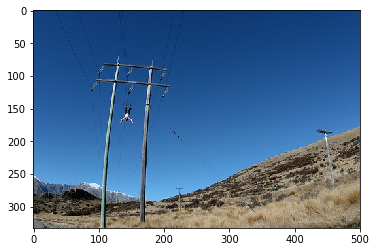

Candidate:  man is sitting on the edge of large rock 
Reference:  person hanging from telephone pole near the mountains
Reference:  person is hanging in the air from the power lines
Reference:  person is hanging upside down from power lines
Reference:  person hanging upside down from poles
Reference:  someone is suspended from electrical wires
Bleu_1 score:  0.2222222222222222
Bleu_2 score:  7.031791076575252e-155
Bleu_3 score:  1.6309584783156364e-185
Bleu_4 score:  1.2508498911928379e-231


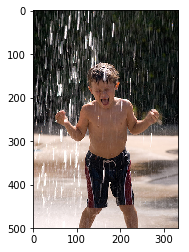

Candidate:  boy in red shorts is jumping into the water 
Reference:  boy enjoys rain shower
Reference:  boy in bathing trunks is standing under water shower
Reference:  boy in swim trunks screams while being sprayed with water
Reference:  boy is squinting while being sprayed with water from flat ground surface
Reference:  boy wearing black swimming trunks is standing in fountain
Bleu_1 score:  0.4444444444444444
Bleu_2 score:  0.23570226039551587
Bleu_3 score:  2.1262855015914924e-93
Bleu_4 score:  7.241926111174567e-155


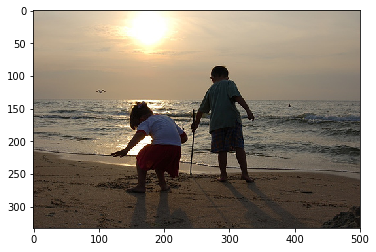

Candidate:  two girls are playing badminton in the grass 
Reference:  boy and girl playing on the beach
Reference:  small boy and girls are playing in the sand on the beach
Reference:  two children one of which is holding stick are standing on the beach as the sun begins to set
Reference:  two children on the beach silhouetted by the setting sun
Reference:  two young children playing with sticks at the beach
Bleu_1 score:  0.75
Bleu_2 score:  0.5669467095138409
Bleu_3 score:  0.41560423878293357
Bleu_4 score:  5.87583260478785e-78


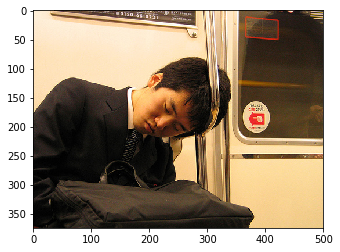

Candidate:  man in black shirt is sitting on the street 
Reference:  man sleeping with bag on his lap on public transportation
Reference:  man who has fallen asleep on public transportation
Reference:  an asian man in suit on the subway asleep
Reference:  tired business man takes quick nap while riding the train
Reference:  young man in suit and tie leans against railing to take nap on public transit
Bleu_1 score:  0.4444444444444444
Bleu_2 score:  0.33333333333333337
Bleu_3 score:  2.6177645164606753e-93
Bleu_4 score:  8.612150057732663e-155


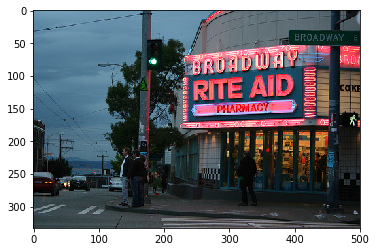

Candidate:  man is sitting on the balcony of the sidewalk 
Reference:  people stand on street corner at dusk with pharmacy in the background
Reference:  people stand outside of the rite aid pharmacy on broadway
Reference:  people waiting to cross the street in front of pharmacy with lit up sign
Reference:  some people look to cross the street in front of drug store
Reference:  this is picture of broadway rite aid pharmacy that has bright neon sign and people are prepared to cross the street in front of it
Bleu_1 score:  0.39770636302860873
Bleu_2 score:  0.2109156496639261
Bleu_3 score:  1.9026838655964303e-93
Bleu_4 score:  6.480360213743594e-155


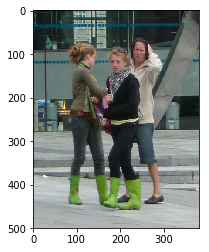

Candidate:  two children are playing on trampoline 
Reference:  three women standing on city street
Reference:  three women walk down the street
Reference:  two girls and woman walking on the sidewalk
Reference:  two girls in bright green boots and woman are together
Reference:  two young ladies in green boots are walking through an urban area while an older lady wearing black shoes follows them
Bleu_1 score:  0.5
Bleu_2 score:  1.0547686614863434e-154
Bleu_3 score:  2.0801644027471386e-185
Bleu_4 score:  1.5319719891192393e-231


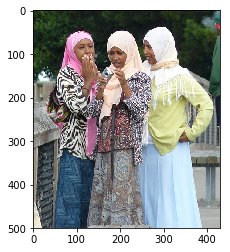

Candidate:  two girls are playing with toys 
Reference:  three females wearing head scarves standing together
Reference:  three muslim women are looking at camera
Reference:  three women in dresses and head scarves outside
Reference:  three women in head scarves examine camera
Reference:  three women with head scarves and long skirts
Bleu_1 score:  0.28216057496353797
Bleu_2 score:  7.2900276358863456e-155
Bleu_3 score:  1.5591498913318325e-185
Bleu_4 score:  1.171778691554733e-231


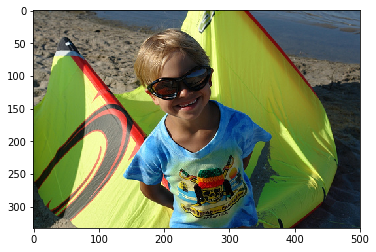

Candidate:  young boy is sitting on the edge of the water 
Reference:  blond boy in blue tee shirts stands smiling before craft of green nylon fabric
Reference:  child poses wearing glasses near water outside
Reference:  small girl smiling on the beach
Reference:  young kid at the beach
Reference:  young man wearing swimming goggles wearing blue shirt with pirate skull on it
Bleu_1 score:  0.6
Bleu_2 score:  0.25819888974716104
Bleu_3 score:  2.245825205383813e-93
Bleu_4 score:  7.57965434483665e-155


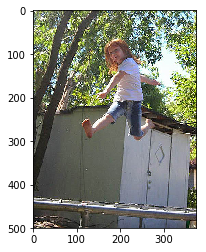

Candidate:  young boy in red shirt is jumping on swing 
Reference:  barefoot redheaded girl jumping over rail
Reference:  girl jumps on the trampoline
Reference:  young girl jumping over railing or ladder on its side
Reference:  the small red haired girl jumps on the trampoline under the tree by the shed
Reference:  the young child with red hair bounced on the trampoline
Bleu_1 score:  0.39770636302860873
Bleu_2 score:  8.898688699301465e-155
Bleu_3 score:  1.7967885069168788e-185
Bleu_4 score:  1.331091014027761e-231


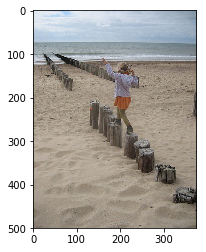

Candidate:  two people are sitting on the beach 
Reference:  blonde girl is stepping on vertical logs in the sand
Reference:  little girl is walking along line of logs on sandy beach
Reference:  young girl balances on wooden pylons at the beach
Reference:  young girl is walking on stumps on the beach next to the ocean
Reference:  girl walking along the tops of wooden posts set into sand on beach
Bleu_1 score:  0.32206169703226534
Bleu_2 score:  0.284031719055601
Bleu_3 score:  0.25863985552473195
Bleu_4 score:  3.7734183673994593e-78


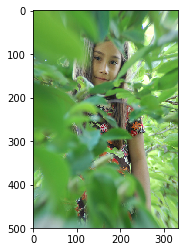

Candidate:  young boy in pink shirt is playing on bed 
Reference:  girl in flowered dress peaking through some leaves
Reference:  girl peeks through the leaves on tree
Reference:  girl peeks through the green leaves
Reference:  young girl peers through the green foliage
Reference:  young girl face looking through leaves
Bleu_1 score:  0.3333333333333333
Bleu_2 score:  8.612150057732663e-155
Bleu_3 score:  1.8419179593432007e-185
Bleu_4 score:  1.384292958842266e-231


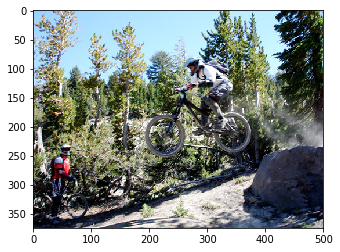

Candidate:  man in blue shirt and helmet riding bike down dirt path 
Reference:  helmeted man jumping off rock on mountain bike
Reference:  man jumping on his bmx with another bmxer watching
Reference:  mountain biker is jumping his bike over rock as another cyclist stands on the trail watching
Reference:  person taking jump off rock on dirt bike
Reference:  the bike rider jumps off rock
Bleu_1 score:  0.2727272727272727
Bleu_2 score:  7.789982830837433e-155
Bleu_3 score:  1.7343040158223243e-185
Bleu_4 score:  1.3165594234639305e-231


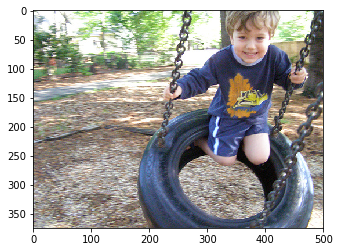

Candidate:  little boy in pink shirt is running on the grass 
Reference:  boy rides on tire swing
Reference:  boy swinging on tireswing
Reference:  small boy in horizontal tire swing
Reference:  young boy smiles at the camera from the tire swing
Reference:  young boy swinging on tire swing
Bleu_1 score:  0.4
Bleu_2 score:  0.21081851067789192
Bleu_3 score:  1.9886052149911737e-93
Bleu_4 score:  6.8489908526642754e-155


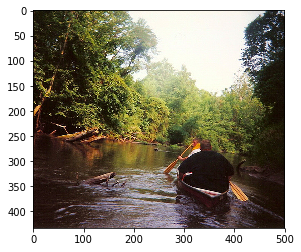

Candidate:  man is walking on the beach 
Reference:  large man sits in the back of canoe with another man in front on river
Reference:  two man are paddling kayak along river with green trees on either side
Reference:  two men in small boat rowing down river
Reference:  two men paddling canoe down narrow stream
Reference:  two paddlers propel canoe down treelined stream
Bleu_1 score:  0.423240862445307
Bleu_2 score:  8.92842395935524e-155
Bleu_3 score:  1.7608211516934517e-185
Bleu_4 score:  1.2967862918337585e-231


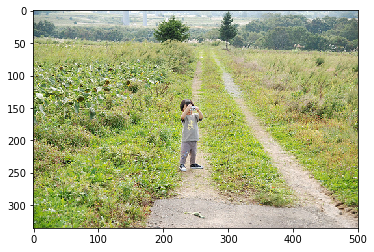

Candidate:  two girls are playing in the grass 
Reference:  boy is playing with camera whilst standing on dirt track
Reference:  child in field
Reference:  kid standing in the middle of dirt road
Reference:  young child stands in path in field of sunflowers
Reference:  small child with black hair standing in car track near sunflowers
Bleu_1 score:  0.37151909989293497
Bleu_2 score:  0.23168286407366764
Bleu_3 score:  1.9875719080152113e-93
Bleu_4 score:  6.684949609530091e-155


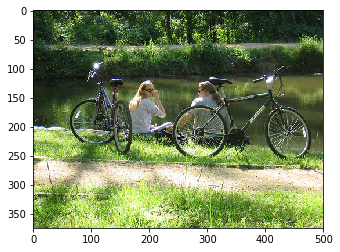

Candidate:  man in black shirt is riding bicycle on the road 
Reference:  two bicycles are standing behind two people sitting on the grass near body of water
Reference:  two blonde women sit beside their bicycles in the grass beside body of water
Reference:  two girls are sitting on path by river with their bicycles parked beside them
Reference:  two people are sitting by pond next to their bikes
Reference:  two women sitting in the grass with their bikes behind them
Bleu_1 score:  0.3
Bleu_2 score:  0.18257418583505533
Bleu_3 score:  1.8241769048702255e-93
Bleu_4 score:  6.373704167435469e-155


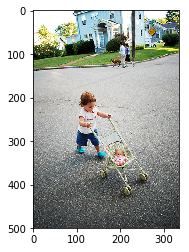

Candidate:  young boy in pink shirt is jumping on swing 
Reference:  child pushes doll in baby carriage
Reference:  little girl pushing baby doll stroller
Reference:  little kid in blue shoes is pushing toy baby in stroller
Reference:  small child pushes stroller down the street
Reference:  young child carrying doll in stroller
Bleu_1 score:  0.3333333333333333
Bleu_2 score:  8.612150057732663e-155
Bleu_3 score:  1.8419179593432007e-185
Bleu_4 score:  1.384292958842266e-231


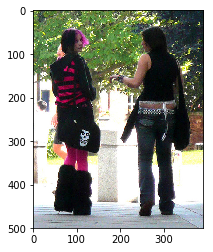

Candidate:  two girls are playing in the grass 
Reference:  girl with pink streaked hair and fur uggs looks back while the girl walking next to her looks at her
Reference:  two girls facing each other one has skull face bag wearing red and black shirt the other is wearing beaded belt
Reference:  two girls walking down the street
Reference:  two girls wearing goth trendy clothing while one looks back at the camera
Reference:  two young girls wearing goth clothes
Bleu_1 score:  0.42857142857142855
Bleu_2 score:  0.26726124191242434
Bleu_3 score:  2.2927933779232266e-93
Bleu_4 score:  7.711523862191631e-155


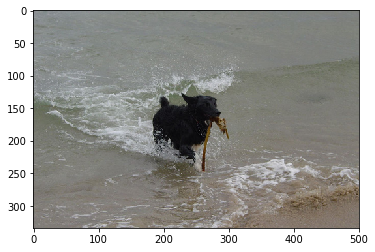

Candidate:  black dog is running through the water 
Reference:  black dog carrying an object out of the water
Reference:  black dog carrying some seaweed out of the water
Reference:  black dog is coming out of the ocean water on the beach with something in its mouth
Reference:  black dog with stick in its mouth is walking out of the water onto beach
Reference:  dog retrieves branch from on beach
Bleu_1 score:  0.7142857142857143
Bleu_2 score:  0.5976143046671969
Bleu_3 score:  0.4530661222656876
Bleu_4 score:  6.313993041533344e-78


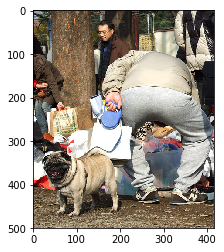

Candidate:  two girls are sitting on the floor 
Reference:  dog waits as his owner rummages through collection of stuff
Reference:  man holding the leash of pug bends down to look in bin at an outdoor rummage sale
Reference:  man with pug dog bends over to pick something off the sidewalk
Reference:  man with pug on leash bending down to examine merchandise
Reference:  person holding small dog on leash is bending over and looking through items
Bleu_1 score:  0.18612544500887301
Bleu_2 score:  5.194120096460954e-155
Bleu_3 score:  1.1456713137525592e-185
Bleu_4 score:  8.676910262183261e-232


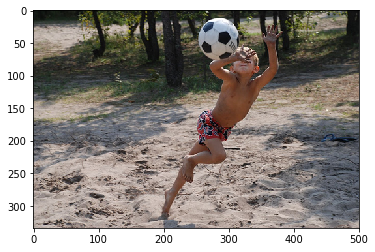

Candidate:  young boy in pink shirt is jumping off of rock 
Reference:  boy in red and blue shorts is trying to catch soccer ball while running in sand
Reference:  young boy wearing red bathing suit reaches for soccer ball
Reference:  kid guards face from soccer ball
Reference:  the little boy in red trunks is attempting to catch soccer ball that is coming towards him
Reference:  young boy plays ball on the beach
Bleu_1 score:  0.4
Bleu_2 score:  0.2981423969999719
Bleu_3 score:  2.448260200784965e-93
Bleu_4 score:  8.14486865257726e-155


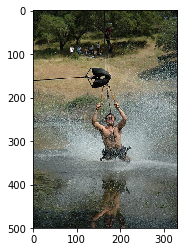

Candidate:  man in black wetsuit is canoeing in the ocean 
Reference:  man in harness being dragged across the water
Reference:  man in harness lands in the water
Reference:  man on tag line going into the water
Reference:  man on zip line being propelled through the water
Reference:  man wearing bathing trunks is parasailing in the water
Bleu_1 score:  0.5555555555555556
Bleu_2 score:  0.372677996249965
Bleu_3 score:  2.799004395628975e-93
Bleu_4 score:  9.106239987484608e-155


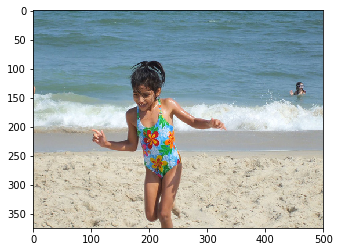

Candidate:  young boy in pink shorts is jumping into pool 
Reference:  girl smiles as she runs across the white sandy beach in her swimsuit
Reference:  little girl in flowered bathingsuit runs through the sand at the beach
Reference:  little girl in flower swimsuit running across the beach with waves in the background
Reference:  there is little girl running on the beach
Reference:  the young girl is running on sandy beach
Bleu_1 score:  0.3333333333333333
Bleu_2 score:  8.612150057732663e-155
Bleu_3 score:  1.8419179593432007e-185
Bleu_4 score:  1.384292958842266e-231


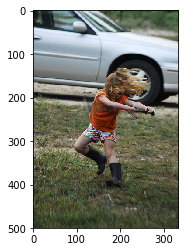

Candidate:  young boy in pink shirt is jumping on swing 
Reference:  girl in boots is active in the grass
Reference:  girl is playing in the mud near car
Reference:  young girl in front of silver car wearing boots demonstrates some interesting moves
Reference:  little girl moving quickly on grass beside silver car
Reference:  the little girl is spinning around making her hair fly in front of the silver car
Bleu_1 score:  0.4444444444444444
Bleu_2 score:  9.94445430826712e-155
Bleu_3 score:  2.0079454189758342e-185
Bleu_4 score:  1.4875195904069663e-231


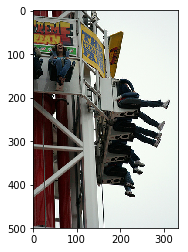

Candidate:  man is sitting on bench with his bike 
Reference:  person is laughing on roller coaster ride
Reference:  photo of ride at an amusement park on an overcast day
Reference:  people are in ride that drops you from great height
Reference:  people on an amusement park ride
Reference:  people on ride at fair
Bleu_1 score:  0.25
Bleu_2 score:  7.458340731200295e-155
Bleu_3 score:  1.6896185209462903e-185
Bleu_4 score:  1.2882297539194154e-231


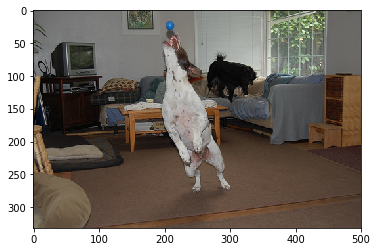

Candidate:  two girls are playing tug of war 
Reference:  dog on two legs with its mouth opened toward blue ball in the air
Reference:  white dog catching blue ball
Reference:  white dog jumps to catch blue ball in living room
Reference:  the dog is jumping in the air to catch ball
Reference:  two dogs in family room are playing one is catching ball in its mouth
Bleu_1 score:  0.42857142857142855
Bleu_2 score:  0.26726124191242434
Bleu_3 score:  2.2927933779232266e-93
Bleu_4 score:  7.711523862191631e-155


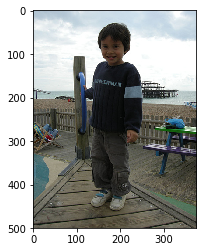

Candidate:  young boy in pink shirt is jumping off of wooden bridge 
Reference:  child in black shirt standing on wooden dock near picnic table
Reference:  little boy is smiling for the camera on playground
Reference:  young boy holds onto blue handle on pier
Reference:  young child stands on wood dock next to the water
Reference:  boy in green sweater with white stripe on sleeve standing on wood planked floor with body of water in the background
Bleu_1 score:  0.6363636363636364
Bleu_2 score:  0.35675303400633784
Bleu_3 score:  2.7266157220135394e-93
Bleu_4 score:  8.909555824566607e-155


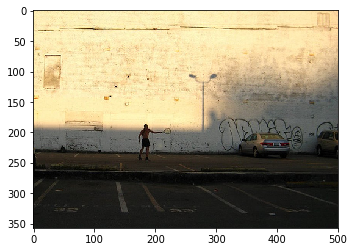

Candidate:  man is sitting on the edge of large rock 
Reference:  man in the near distance is pointing to silver sedan near him
Reference:  man is playing tennis with himself against large wall in parking lot
Reference:  man walks toward car in parking lot
Reference:  man stands outside against wall with tennis racket in dark
Reference:  the man is playing tennis against the building
Bleu_1 score:  0.4444444444444444
Bleu_2 score:  0.23570226039551587
Bleu_3 score:  2.1262855015914924e-93
Bleu_4 score:  7.241926111174567e-155


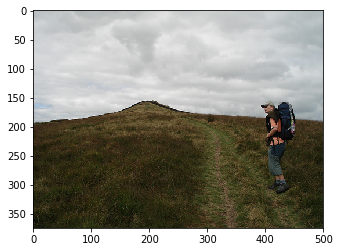

Candidate:  man is walking on the edge of the ocean 
Reference:  hiker is walking treeless path up hill
Reference:  man is backpacking up grassy hill
Reference:  man with big backpack is walking through grass trail up hill
Reference:  person hiking up grassy trail toward large hill
Reference:  the hiker is following trail uphill
Bleu_1 score:  0.4444444444444444
Bleu_2 score:  0.33333333333333337
Bleu_3 score:  2.6177645164606753e-93
Bleu_4 score:  8.612150057732663e-155


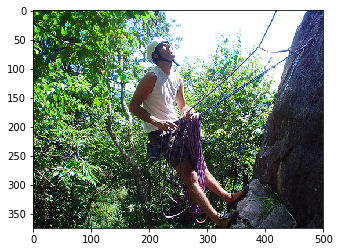

Candidate:  young boy is jumping off of slide 
Reference:  man in harness climbing rock wall
Reference:  man with white shirt and helmet is climbing mountain
Reference:  man in white shirt and helmet is using climbing equipment
Reference:  young man wearing white helmet climbing up rock wall
Reference:  man rock climbing looking up the rock
Bleu_1 score:  0.2857142857142857
Bleu_2 score:  7.973301625706314e-155
Bleu_3 score:  1.7586776545063733e-185
Bleu_4 score:  1.331960397810445e-231


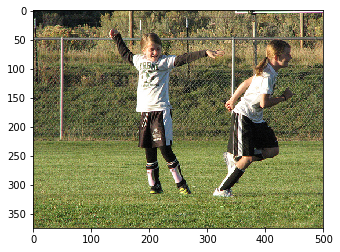

Candidate:  two boys playing soccer on field 
Reference:  children participate in sport on green field while in uniforms
Reference:  the young soccer player enjoys the game
Reference:  two girls in soccer strips are playing on sports field
Reference:  two girls play on fenced in field
Reference:  two girls wearing black and white uniforms run down grassy field
Bleu_1 score:  0.7054014374088451
Bleu_2 score:  1.1526545767487326e-154
Bleu_3 score:  2.0524371708388528e-185
Bleu_4 score:  1.4734336989510458e-231


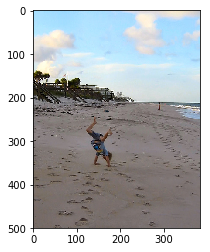

Candidate:  young boy is jumping into the water 
Reference:  boy doing handstand on the beach
Reference:  child does handstand on the sand at the beach
Reference:  child doing handstand on the beach
Reference:  little boy does cartwheel on the beach
Reference:  little boy doing handstand on the beach
Bleu_1 score:  0.2857142857142857
Bleu_2 score:  7.973301625706314e-155
Bleu_3 score:  1.7586776545063733e-185
Bleu_4 score:  1.331960397810445e-231


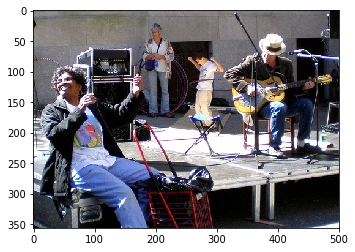

Candidate:  two men are sitting on the street 
Reference:  guitarist plays while people play with hulahoops in the background
Reference:  guitarist sits playing before microphones while man and boy dance and woman stands by
Reference:  man in white hat plays guitar on stage
Reference:  man plays guitar on stage while another woman smiles
Reference:  four people performing music outdoors
Bleu_1 score:  0.24767939992862334
Bleu_2 score:  6.9118789673669984e-155
Bleu_3 score:  1.5245587914760605e-185
Bleu_4 score:  1.154647032204335e-231


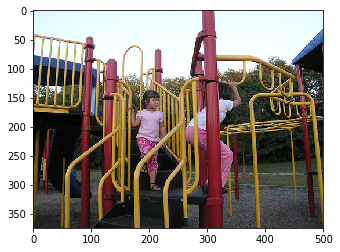

Candidate:  two children are playing on the rails 
Reference:  the two girls are playing on yellow and red jungle gym
Reference:  two girls play at park
Reference:  two little girls both dressed in pink play on the jungle gym
Reference:  two little girls in pink are in playground
Reference:  two young girls wearing pink playing on playground
Bleu_1 score:  0.6191984998215584
Bleu_2 score:  0.5180586332905649
Bleu_3 score:  0.3927530085176383
Bleu_4 score:  5.473461026881688e-78


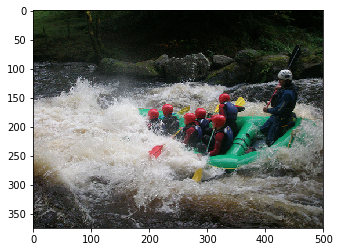

Candidate:  man is walking through the water 
Reference:  group of people in boat white water rafting
Reference:  group of seven people are rafting in the rapids in green boat
Reference:  rafting boat on river
Reference:  seven people are riding green raft in white water river
Reference:  seven rafters are paddling and riding the rapids in green raft
Bleu_1 score:  0.3333333333333333
Bleu_2 score:  8.612150057732663e-155
Bleu_3 score:  1.8419179593432007e-185
Bleu_4 score:  1.384292958842266e-231


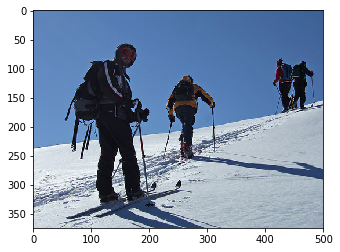

Candidate:  man in red shirt is walking down the snow 
Reference:  group of skiers going up mountain
Reference:  four crosscountry skiers climb uphill
Reference:  four people climbing hill in the snow
Reference:  four skiers walking up snow covered hill
Reference:  four skiers climbing snow drapped mountain
Bleu_1 score:  0.4444444444444444
Bleu_2 score:  0.23570226039551587
Bleu_3 score:  2.1262855015914924e-93
Bleu_4 score:  7.241926111174567e-155


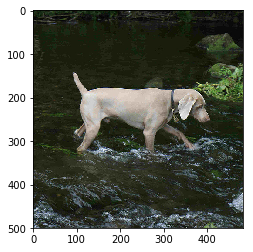

Candidate:  brown dog is running through the water 
Reference:  dog is trotting through shallow stream
Reference:  light colored dog is walking through stream
Reference:  male weimaraner with clipped tail is walking through river
Reference:  tan dog walking along in stream
Reference:  the brown dog is walking through river surrounded by bushes
Bleu_1 score:  0.7142857142857143
Bleu_2 score:  0.48795003647426655
Bleu_3 score:  0.40117532357973634
Bleu_4 score:  5.705336763108155e-78


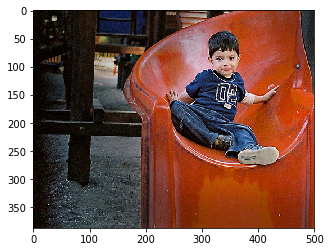

Candidate:  boy is playing with metal toy 
Reference:  child on red slide
Reference:  little boy sits on slide on the playground
Reference:  little boy slides down bright red corkscrew slide
Reference:  little boy slides down red slide
Reference:  young boy wearing blue outfit sliding down red slide
Bleu_1 score:  0.16666666666666669
Bleu_2 score:  6.08970970641905e-155
Bleu_3 score:  1.4961022763680928e-185
Bleu_4 score:  1.1640469867513693e-231


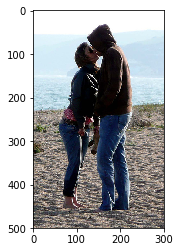

Candidate:  man is sitting on the beach by the ocean 
Reference:  couple dressed in hoodies kissing on the beach
Reference:  man and woman share kiss on the beach
Reference:  man with brown hooded jacket is kissing girl with sunglasses
Reference:  there is couple kissing on the beach
Reference:  two people kiss on the beach
Bleu_1 score:  0.5555555555555556
Bleu_2 score:  0.372677996249965
Bleu_3 score:  0.3085111318413486
Bleu_4 score:  4.583829695130767e-78


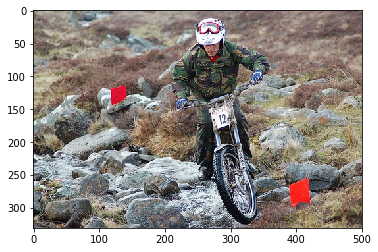

Candidate:  man in red shirt riding bike down dirt path 
Reference:  man dressed in camouflage riding motorbike
Reference:  man is going between two red flag markers on dirt bike
Reference:  man is riding dirt bike over some rocks
Reference:  man wearing camouflage steers motorcycle across some stones
Reference:  the man waeribng helmet is riding dirt bike over rocks
Bleu_1 score:  0.6666666666666666
Bleu_2 score:  1.2179419412838124e-154
Bleu_3 score:  2.2676670054850644e-185
Bleu_4 score:  1.646211035903463e-231


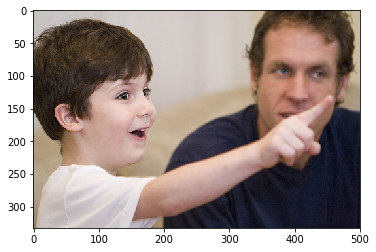

Candidate:  young boy in pink shirt is petting pasta 
Reference:  boy points
Reference:  boy points at something while man looks
Reference:  boy smiles at points at something man looks to the side
Reference:  little boy smiles and points while man looks in the direction of the child gaze
Reference:  the man in the blue shirt is looking in the direction to which the little boy is pointing
Bleu_1 score:  0.5
Bleu_2 score:  0.26726124191242434
Bleu_3 score:  2.2927933779232266e-93
Bleu_4 score:  7.711523862191631e-155


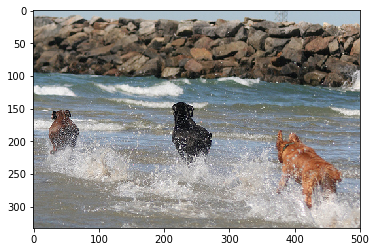

Candidate:  two dogs play in the water 
Reference:  brown black and tan dog run in the ocean
Reference:  three dogs run into the water
Reference:  three dogs running through water
Reference:  three dogs run through surf near rocky outcrop
Reference:  three dogs run through the water near the rocks and make splashes
Bleu_1 score:  0.6666666666666666
Bleu_2 score:  0.5163977794943222
Bleu_3 score:  3.404034469286905e-93
Bleu_4 score:  1.0719249972567852e-154


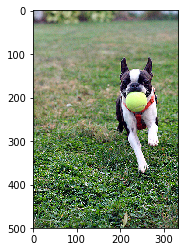

Candidate:  dog running through the grass 
Reference:  dog is running with yellow tennis ball and wearing red harness
Reference:  small black and white dog running through the grass with tennis ball in his mouth
Reference:  small black and white dog wearing red harness is running around with ball in its mouth
Reference:  small dog with red harness fetching ball
Reference:  the dog wearing the red collar is running across the grass with ball in its mouth
Bleu_1 score:  0.6703200460356393
Bleu_2 score:  0.6703200460356393
Bleu_3 score:  0.6703200460356393
Bleu_4 score:  0.6703200460356393


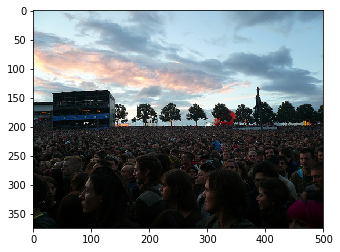

Candidate:  group of people are standing in front of building 
Reference:  boxy building group of trees church at sunset
Reference:  crowd of people are gathered with sky scene in the background
Reference:  crowd of people at an outdoor event
Reference:  very large group of people stand outdoors under the beautiful clouds
Reference:  large crowd of people gathered together
Bleu_1 score:  0.6666666666666666
Bleu_2 score:  0.5
Bleu_3 score:  0.45306612226568754
Bleu_4 score:  6.313993041533344e-78


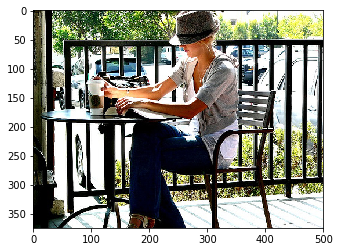

Candidate:  man in black shirt and hat is sitting on the street 
Reference:  girl is reading while drinking starbuck coffee
Reference:  seated young woman in hat is reading at coffee shop
Reference:  woman enjoying her reading at coffee shop
Reference:  woman in hat sits reading and drinking coffee
Reference:  young woman sips coffee and reads book
Bleu_1 score:  0.36363636363636365
Bleu_2 score:  0.19069251784911848
Bleu_3 score:  1.8724210775784562e-93
Bleu_4 score:  6.513869329968086e-155


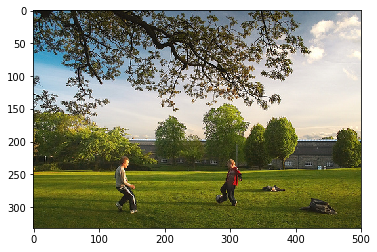

Candidate:  two girls are playing badminton on the grass 
Reference:  boys kicking soccer ball in the grass under tree
Reference:  two boys are kicking ball to each other in the park
Reference:  two boys have made goal out of two jackets in order to play soccer
Reference:  two boys kick around ball in meadow
Reference:  two kids play soccer in field
Bleu_1 score:  0.5
Bleu_2 score:  0.26726124191242434
Bleu_3 score:  2.2927933779232266e-93
Bleu_4 score:  7.711523862191631e-155


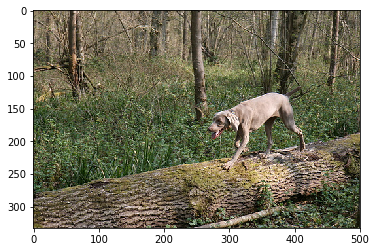

Candidate:  dog runs through the grass 
Reference:  big hound dog walking on log in the woods
Reference:  brown dog walks on top of felled tree trunk
Reference:  grey dog walks on top of fallen tree in the woods
Reference:  skinny brown dog walks across large piece of fallen tree
Reference:  the skinny brown dog is walking on fallen tree
Bleu_1 score:  0.17973158564688863
Bleu_2 score:  4.239031324788977e-155
Bleu_3 score:  8.741562574645582e-186
Bleu_4 score:  6.510101141652543e-232


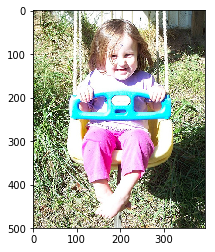

Candidate:  little boy in pink shirt is running on the grass 
Reference:  little girl in swing laughs
Reference:  little girl is swinging in her brightly colored swing outside
Reference:  little girl sits in plastic swing set
Reference:  young girl on swing
Reference:  girl wearing pink pants smiles in baby swing
Bleu_1 score:  0.5
Bleu_2 score:  1.0547686614863434e-154
Bleu_3 score:  2.0801644027471386e-185
Bleu_4 score:  1.5319719891192393e-231


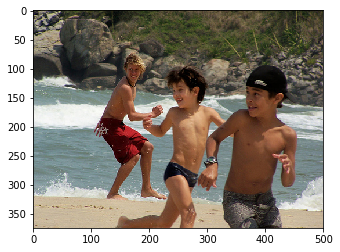

Candidate:  two boys play in the water 
Reference:  children playing at the beach
Reference:  little boy in red shorts boy in black speedo and boy in grey shorts are all running on the beach
Reference:  three boys are running on the beach playing game
Reference:  three boys play tag on the beach
Reference:  two young boys and one young man run on beach with water behind them
Bleu_1 score:  1.0
Bleu_2 score:  0.447213595499958
Bleu_3 score:  3.1225710439881898e-93
Bleu_4 score:  9.975386110402101e-155


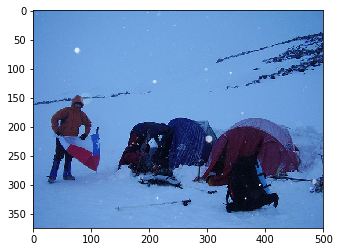

Candidate:  man in red shirt is climbing up cliff 
Reference:  man holds flag next to snowbound campsite
Reference:  man with texas flag stands in the snow by tents
Reference:  person setting up tent beside few other tents on the snowy ground
Reference:  mountain climbers are setting up their tents
Reference:  with pack and ski pole on the ground man wearing winter coat is holding tent while other tents are already set up
Bleu_1 score:  0.5
Bleu_2 score:  1.0547686614863434e-154
Bleu_3 score:  2.0801644027471386e-185
Bleu_4 score:  1.5319719891192393e-231


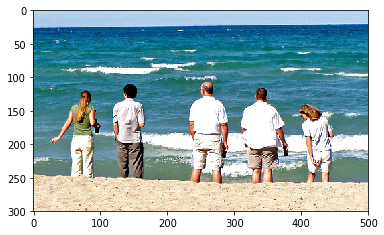

Candidate:  two girls are playing in the water 
Reference:  group of people stand in the sand looking out at the water
Reference:  five people look out toward the ocean
Reference:  five people standing in front of body of water
Reference:  three men and two women stand facing the ocean from the shore on sunny day
Reference:  two ladies and three men looking at the ocean
Bleu_1 score:  0.5714285714285714
Bleu_2 score:  0.4364357804719847
Bleu_3 score:  3.0771986866000245e-93
Bleu_4 score:  9.85444998995587e-155


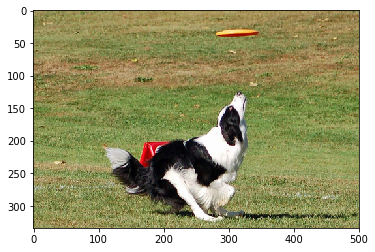

Candidate:  dog running through the grass 
Reference:  black and white dog is going after an orange frisbee
Reference:  black and white dog leaps to catch an orange frisbee
Reference:  black and white dog prepares to catch frisbee
Reference:  dog about to jump to catch frisbee
Reference:  dog jumping for frisbee
Bleu_1 score:  0.2
Bleu_2 score:  6.6709427497276e-155
Bleu_3 score:  1.5802130991274054e-185
Bleu_4 score:  1.2183324802375697e-231


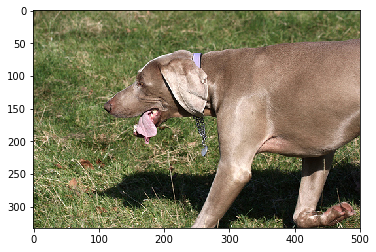

Candidate:  brown dog is running through the grass 
Reference:  brown dog is panting hard on grass during sunny day
Reference:  brown dog walks in the grass with its tongue hanging out
Reference:  dog running with tongue hanging out
Reference:  grey dog walks in the green grass tongue hanging out
Reference:  tan dog jogging with his tongue hanging out
Bleu_1 score:  0.8571428571428571
Bleu_2 score:  0.6546536707079771
Bleu_3 score:  0.4785374853603616
Bleu_4 score:  6.608446987146148e-78


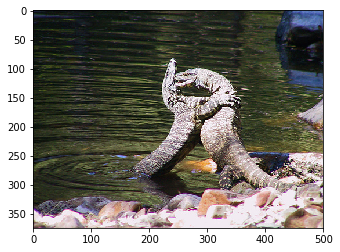

Candidate:  man is sitting on the beach by the ocean 
Reference:  the iguanas wrestled along the rocky water bank
Reference:  the two reptiles are standing on their back legs near deep water
Reference:  two lizards fighting
Reference:  two lizards fight in the water
Reference:  two oriental lizards are fighting for dominance in small pond
Bleu_1 score:  0.3333333333333333
Bleu_2 score:  8.612150057732663e-155
Bleu_3 score:  1.8419179593432007e-185
Bleu_4 score:  1.384292958842266e-231


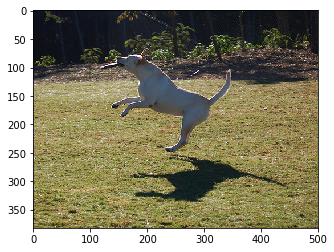

Candidate:  dog runs through the grass 
Reference:  dog is jumping to catch frisbee and casts perfect shadow
Reference:  dog jumps and catches frisbee in the grass
Reference:  dog jumps and catches toy
Reference:  white dog leaps to catch an object
Reference:  yellow lab jumping up to catch toy
Bleu_1 score:  0.6
Bleu_2 score:  0.3872983346207417
Bleu_3 score:  2.8643804910694892e-93
Bleu_4 score:  9.283142785759642e-155


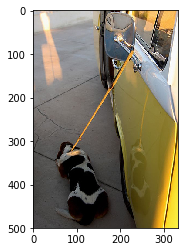

Candidate:  man is sitting on bench with his arms folded 
Reference:  basset hound is leashed to the rearview mirror of yellow and white vehicle
Reference:  black and white dog tied to yellow and white van
Reference:  dog lying down tethered to the side mirror of yellow vw bus
Reference:  dog with black white and brown coloring is leashed up to mirror
Reference:  the black and white dog is tethered next to yellow car
Bleu_1 score:  0.19885318151430437
Bleu_2 score:  6.29232312294398e-155
Bleu_3 score:  1.459445770488568e-185
Bleu_4 score:  1.1193096620723278e-231


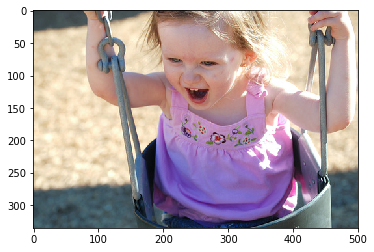

Candidate:  baby in red shirt is playing on bed 
Reference:  little girl on kid swing
Reference:  little girl shouts for joy as she swings on the swing
Reference:  toddler girl in swing is laughing
Reference:  toddler in pink shirt in bucket swing
Reference:  young girl making wide mouthed expression while swinging
Bleu_1 score:  0.5
Bleu_2 score:  1.0547686614863434e-154
Bleu_3 score:  2.0801644027471386e-185
Bleu_4 score:  1.5319719891192393e-231


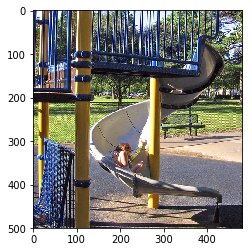

Candidate:  boy is jumping on trampoline 
Reference:  child is on slide
Reference:  child is sliding down spiral slide on playground
Reference:  girl goes down blue and yellow slide at park
Reference:  little girl is sliding down slide at park
Reference:  small girl slides down spiral slide at the playground
Bleu_1 score:  0.4
Bleu_2 score:  9.434137710479516e-155
Bleu_3 score:  1.9454705288851735e-185
Bleu_4 score:  1.4488496539373276e-231


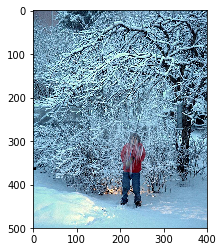

Candidate:  two children are playing in the air 
Reference:  boy in red jacket smacks snow covered tree with stick
Reference:  child stands underneath snowcovered tree
Reference:  little boy shakes the snow off of tree
Reference:  person in red jacket stands under snowcovered tree
Reference:  child standing in snowy landscape pulling down snowcovered tree branch
Bleu_1 score:  0.24767939992862334
Bleu_2 score:  6.9118789673669984e-155
Bleu_3 score:  1.5245587914760605e-185
Bleu_4 score:  1.154647032204335e-231


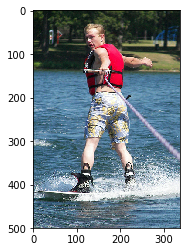

Candidate:  man in black wetsuit is surfing 
Reference:  man in swim trunks and red life vest jet skiing
Reference:  man waterskiing with one hand
Reference:  man wearing red life jacked is holding purple rope while waterskiing
Reference:  man wearing swimming trunks is waterskiing backwards using only one hand
Reference:  person in red ski jacket skiing backwards
Bleu_1 score:  0.5
Bleu_2 score:  0.316227766016838
Bleu_3 score:  2.5363158132719833e-93
Bleu_4 score:  8.38826642100846e-155


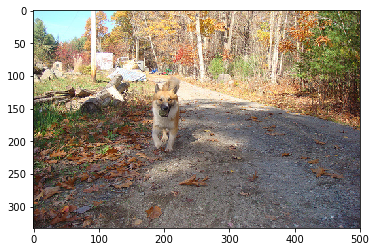

Candidate:  two dogs are running through field 
Reference:  brown and white dog trotting down the road in autumn
Reference:  brown dog is carrying ball up the road
Reference:  dog with ball in his mouth running down road covered in leaves
Reference:  large dog walks along gravel path in the woods
Reference:  tan and white dog retrieving ball on gravel path
Bleu_1 score:  0.11942188509563156
Bleu_2 score:  4.363467676954367e-155
Bleu_3 score:  1.072004124838459e-185
Bleu_4 score:  8.34076112986429e-232


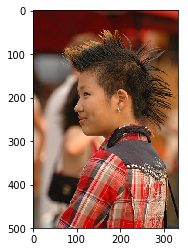

Candidate:  young boy in red shirt is petting pasta 
Reference:  girl with nose ring earring and mohawk
Reference:  person with spiky hair looks to the left
Reference:  profile of young person with punk hairstyle and pierced ear and nose in cowboy shirt
Reference:  young person with mohawk and nose piercing in plaid shirt
Reference:  the person is posing in red flannel shirt with mohawk
Bleu_1 score:  0.625
Bleu_2 score:  0.2988071523335984
Bleu_3 score:  2.4515340103062025e-93
Bleu_4 score:  8.15394372921771e-155


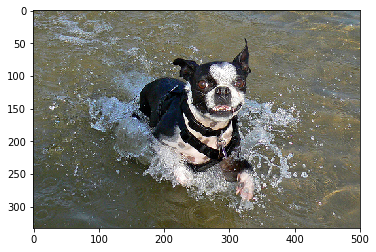

Candidate:  black dog is running through water 
Reference:  black and white dog plays in the water
Reference:  black and white dog walking in shallow water
Reference:  dog splashes through the water
Reference:  dog swims
Reference:  black and white dog wearing harness walking through water
Bleu_1 score:  0.6666666666666666
Bleu_2 score:  0.36514837167011077
Bleu_3 score:  2.764935154957498e-93
Bleu_4 score:  9.013778876140909e-155


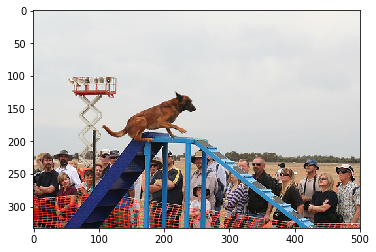

Candidate:  boy in red shirt is jumping off of wooden bridge 
Reference:  crowd is watching dog climb up staircase
Reference:  dog is running through an obstacle course in front of group of people
Reference:  dog performs trick on ladder in front of crowd observing his talent
Reference:  large brown dog walks up blue staircase
Reference:  onlookers watch german shephard climb steps on an obstacle course
Bleu_1 score:  0.3
Bleu_2 score:  8.170202920075766e-155
Bleu_3 score:  1.7846088208682725e-185
Bleu_4 score:  1.3483065280626046e-231


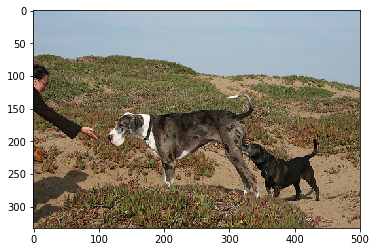

Candidate:  dog runs through the grass 
Reference:  large dog sniffing human hand while small dog is sniffing the large dog butt
Reference:  person reaches for large grey dog while black dog trails
Reference:  smaller dog sniffs larger dog in the hills
Reference:  the black dog is sniffing the brown dog butt
Reference:  the lady ask the dog to give her the ball on their beach walk
Bleu_1 score:  0.21952465443761057
Bleu_2 score:  5.177564552024615e-155
Bleu_3 score:  1.0676968639301828e-185
Bleu_4 score:  7.951455490316087e-232


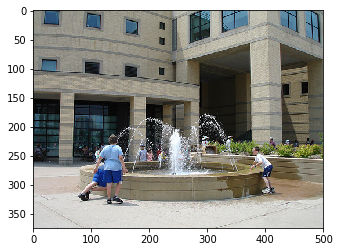

Candidate:  man is sitting on the street reading at the city 
Reference:  few younger boys play around fountain
Reference:  group of people gather around large fountain
Reference:  three boys play around fountain in an office building courtyard
Reference:  three kids are playing at fountain in front of building
Reference:  three kids playing around fountain
Bleu_1 score:  0.10000000000000002
Bleu_2 score:  4.717068855239749e-155
Bleu_3 score:  1.2835318765197405e-185
Bleu_4 score:  1.0244914152188952e-231


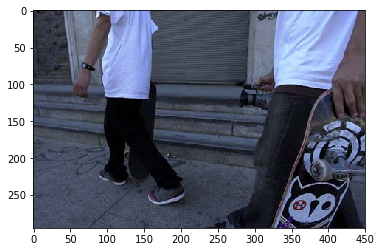

Candidate:  man in black shirt is sitting on the street reading book 
Reference:  the camera focuses on two people legs
Reference:  the legs and midsections of two people with skateboards
Reference:  two guys walking one carrying skateboard
Reference:  two male skaters walk on sidewalk
Reference:  two people wearing white shirts and jeans each carrying skateboard
Bleu_1 score:  0.18181818181818182
Bleu_2 score:  6.360494346864465e-155
Bleu_3 score:  1.535669829502647e-185
Bleu_4 score:  1.1896457329133973e-231


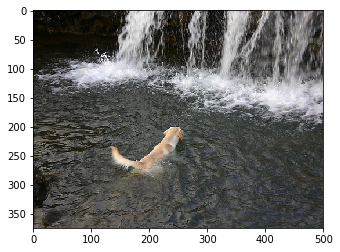

Candidate:  white bird is flying through the water 
Reference:  dog swims towards waterfall
Reference:  tan and white dog swimming towards waterfall
Reference:  yellow dog swims towards waterfall
Reference:  the dog swims through the water toward the waterfall
Reference:  the dog swims towards waterfall
Bleu_1 score:  0.5714285714285714
Bleu_2 score:  0.4364357804719847
Bleu_3 score:  0.37519859868268624
Bleu_4 score:  5.395774370246974e-78


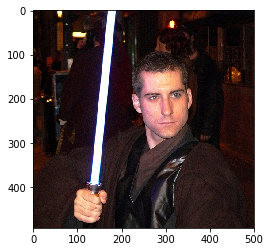

Candidate:  man in black shirt is sitting on the street 
Reference:  man dressed in brown holding light saber
Reference:  man wearing black outfit holding on to glowing sword
Reference:  man dressed up in black and brown and holding white light saber
Reference:  the man holds light sabre
Reference:  the man is playing with his star wars light sword
Bleu_1 score:  0.6666666666666666
Bleu_2 score:  0.28867513459481287
Bleu_3 score:  2.4013140151287052e-93
Bleu_4 score:  8.014508691042773e-155


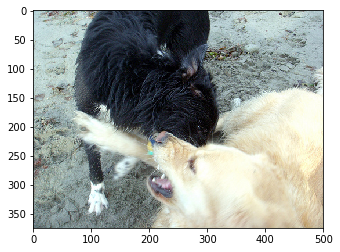

Candidate:  dog is petting sleeping on the grass 
Reference:  black dog and tan dog fighting
Reference:  black dog and white dog are wrestling on the ground
Reference:  black dog bites white dog while standing on the sand
Reference:  two dogs fight
Reference:  two dogs one white and one black play with each other in the sand
Bleu_1 score:  0.42857142857142855
Bleu_2 score:  0.26726124191242434
Bleu_3 score:  2.2927933779232266e-93
Bleu_4 score:  7.711523862191631e-155


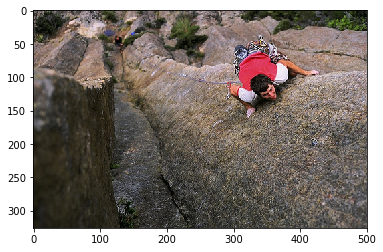

Candidate:  man in red shirt is climbing rock face 
Reference:  man rock climbs up very tall cliff with blue rope behind him
Reference:  man wearing red shirt is climbing up the rock wall
Reference:  young man climbs mountain another follows below
Reference:  man scales rock
Reference:  the climber in red is leading climbers up long rock face
Bleu_1 score:  1.0
Bleu_2 score:  0.8451542547285166
Bleu_3 score:  0.6501674345898532
Bleu_4 score:  0.4671379777282001


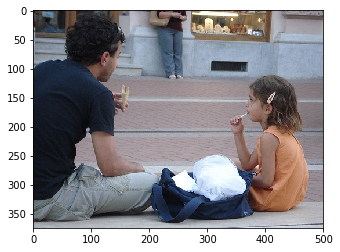

Candidate:  two girls are playing with toys 
Reference:  man and girl sit on the ground and eat
Reference:  man and little girl are sitting on sidewalk near blue bag eating
Reference:  man and young girl eat meal on city street
Reference:  man wearing black shirt and girl wearing an orange shirt sitting on the pavement eating
Reference:  man wearing black shirt and little girl wearing an orange dress share treat
Bleu_1 score:  0.10108844328543891
Bleu_2 score:  3.693595645692774e-155
Bleu_3 score:  9.074319006831119e-186
Bleu_4 score:  7.060301868108111e-232


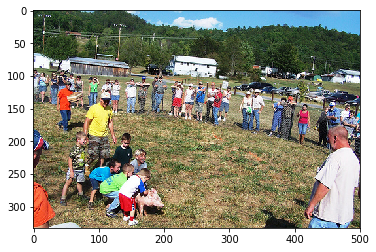

Candidate:  two girls are walking down the street 
Reference:  children participate in sport involving swine among spectators
Reference:  children playing with pig
Reference:  people are gathered around watching children with pig
Reference:  several children pet pig while crowd watches
Reference:  the young children are petting piglet
Bleu_1 score:  0.2857142857142857
Bleu_2 score:  7.973301625706314e-155
Bleu_3 score:  1.7586776545063733e-185
Bleu_4 score:  1.331960397810445e-231


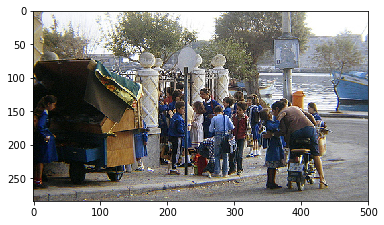

Candidate:  two men are sitting on the sidewalk 
Reference:  girl kisses her mother goodbye before she waits with the other children to start school
Reference:  group of children in blue clothes stand by gate
Reference:  group of students in uniform stand in front of the gate
Reference:  crowd of people near the water
Reference:  group of schoolchildren in uniforms standing at gate one kissing her mother goodbye
Bleu_1 score:  0.14285714285714285
Bleu_2 score:  5.637975647982813e-155
Bleu_3 score:  1.4284901392909564e-185
Bleu_4 score:  1.1200407237786664e-231


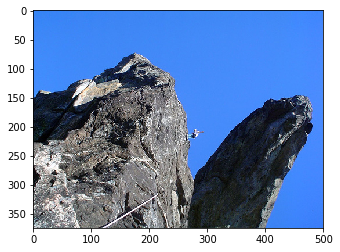

Candidate:  man is sitting on top of mountain 
Reference:  mountain climber looks down from the summit
Reference:  person is rock climbing between two large rock faces
Reference:  rock climber climbs in between two very large rocks
Reference:  rock climber leans out from crag against deep blue sky
Reference:  two large mountains stand high in the air as person tries to climb one
Bleu_1 score:  0.2857142857142857
Bleu_2 score:  7.973301625706314e-155
Bleu_3 score:  1.7586776545063733e-185
Bleu_4 score:  1.331960397810445e-231


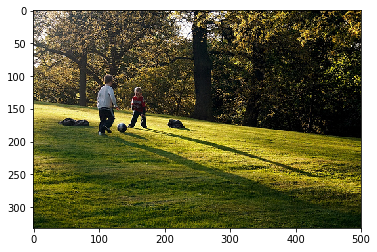

Candidate:  two girls are playing in the grass 
Reference:  two boys in field kicking soccer ball
Reference:  two children are playing with soccer ball on grass
Reference:  two children playing with ball on the grass
Reference:  two children play soccer in the park
Reference:  two little boys are playing outside with their soccer ball on the green grass
Bleu_1 score:  0.8571428571428571
Bleu_2 score:  0.6546536707079771
Bleu_3 score:  3.924734598183211e-93
Bleu_4 score:  1.2069187085583323e-154


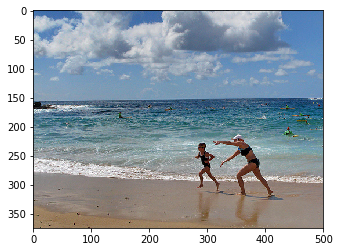

Candidate:  boy in red swim trunks is jumping into the water 
Reference:  an adult and child run on the beach
Reference:  woman and little girl playing in the sand next to the ocean
Reference:  two people run down the beach and one of them is pointing
Reference:  two people running on beach
Reference:  two people running on the shore of beach
Bleu_1 score:  0.3
Bleu_2 score:  8.170202920075766e-155
Bleu_3 score:  1.7846088208682725e-185
Bleu_4 score:  1.3483065280626046e-231


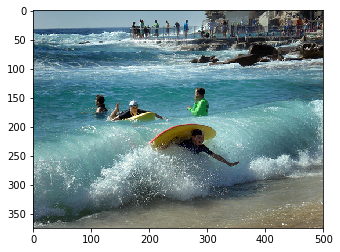

Candidate:  boy is splashing in the water 
Reference:  body boarder is being dumped on the beach by wave whilst other surfers are standing around in the water
Reference:  child is pushed by large wave while holding his yellow surfboard
Reference:  four swimmers in the crystal blue ocean with yellow surfboards
Reference:  people surfboarding and standing in the ocean
Reference:  some wakeboarders riding waves on beach busy with tourists
Bleu_1 score:  0.5643211499270759
Bleu_2 score:  0.4371212831160368
Bleu_3 score:  0.37565589518543135
Bleu_4 score:  5.253283993027542e-78


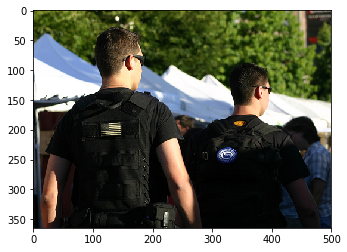

Candidate:  man in black shirt is standing next to the water 
Reference:  men wearing sunglasses with their backs turned to the camera
Reference:  the backs of two men wearing backpacks near some tents
Reference:  two men in black bulletproof vests watch something taking place to the right of the picture
Reference:  two men in black outfits have backpacks
Reference:  two men in bullet proof vests watch over crowd by some white tents
Bleu_1 score:  0.4
Bleu_2 score:  0.2981423969999719
Bleu_3 score:  2.448260200784965e-93
Bleu_4 score:  8.14486865257726e-155


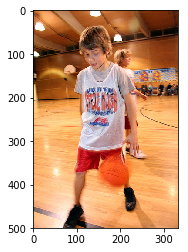

Candidate:  young boy in red shirt is playing on swing 
Reference:  boy dribbles basketball in the gymnasium
Reference:  boy dribbling basketball in gym
Reference:  boy wearing steve nash shirt dribbles basketball on an indoor court
Reference:  child in gray tshirt is bouncing basketball on basketball court
Reference:  one little boy dribbles his basketball
Bleu_1 score:  0.49713295378576094
Bleu_2 score:  9.94903642112384e-155
Bleu_3 score:  1.9211884404621006e-185
Bleu_4 score:  1.40745738725685e-231


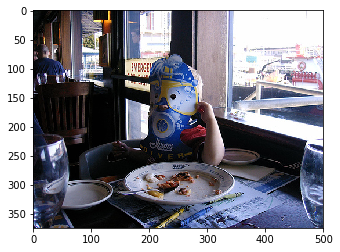

Candidate:  man in black shirt is sitting on the street 
Reference:  child sitting at restaurant table holding paper mask against his face
Reference:  child with mask on sitting at table with plate in front
Reference:  young child wearing mask at ivars
Reference:  child in restaurant posing with paper mask
Reference:  the boy is wearing cardboard scuba mask at the restaurant
Bleu_1 score:  0.49713295378576094
Bleu_2 score:  9.94903642112384e-155
Bleu_3 score:  1.9211884404621006e-185
Bleu_4 score:  1.40745738725685e-231


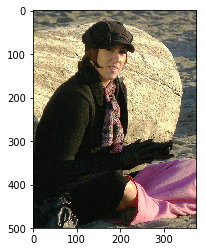

Candidate:  man in black shirt is sitting on the street 
Reference:  girl in black jacket and hat is covered in pink blanket
Reference:  woman derssed in black sweater gloves hat and scarf sits on the beach near boulder
Reference:  woman in black cap and outfit sits in the sand
Reference:  woman wearing black hat sits on the sand with rock behind her
Reference:  the girl sitting by rock is wearing black coat black hat black gloves but is covered by pink blanket
Bleu_1 score:  0.596559544542913
Bleu_2 score:  0.3653166213293175
Bleu_3 score:  2.6454710412601165e-93
Bleu_4 score:  8.52863367187932e-155


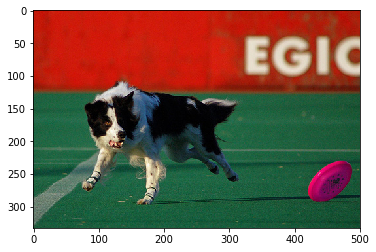

Candidate:  two dogs play with ball 
Reference:  black and white dog chases pink frisbee
Reference:  black and white dog is chasing ping frisbee
Reference:  black and white dog is looking at pink frisbee on court
Reference:  black and white dog is running with pink frisbee next to him
Reference:  dog runs to catch frisbee on astroturf
Bleu_1 score:  0.13406400920712788
Bleu_2 score:  4.471666651098519e-155
Bleu_3 score:  1.0592485173532027e-185
Bleu_4 score:  8.166726842395623e-232


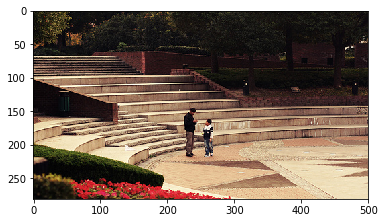

Candidate:  man is sitting on bus with his belongings 
Reference:  man and child stand at the bottom of an outdoor staircase near benches
Reference:  man and young boy are standing looking at each other in an outdoor garden area
Reference:  man in an ampitheater talking to boy
Reference:  man talks to boy in vacant area
Reference:  the man and the boy are standing at the bottom of the outdoor stairs
Bleu_1 score:  0.12500000000000003
Bleu_2 score:  5.273843307431707e-155
Bleu_3 score:  1.3723966925664941e-185
Bleu_4 score:  1.0832677820940877e-231


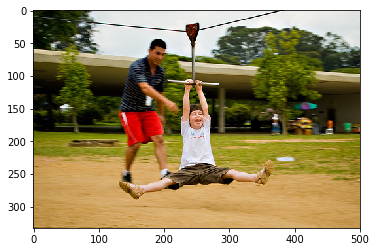

Candidate:  two boys play in the air 
Reference:  boy hangs from tbar while man gives him push
Reference:  little boy being pushed by an older person on playground
Reference:  little boy is going down pulley swing
Reference:  man pushes boy on zip line
Reference:  smiling boy slides down rope while hanging on
Bleu_1 score:  0
Bleu_2 score:  0
Bleu_3 score:  0
Bleu_4 score:  0


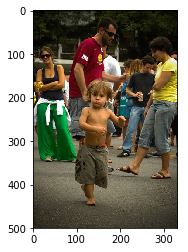

Candidate:  two girls are playing in the grass 
Reference:  boy without shirt is running in the street while several people stand behind him
Reference:  little boy dances with group of people behind him on city street
Reference:  small boy dances on the concrete surrounded by adults
Reference:  the little boy wearing no shirt is running by crowd of people
Reference:  the shirtless little boy is walking around adults
Bleu_1 score:  0.24767939992862334
Bleu_2 score:  0.18916826637569276
Bleu_3 score:  1.759930315134887e-93
Bleu_4 score:  6.040533861202418e-155


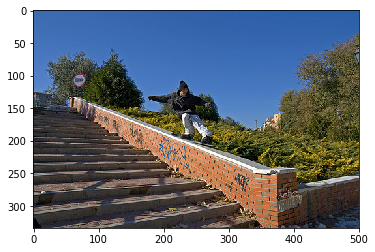

Candidate:  man is sitting on the edge of large rock 
Reference:  man in black hoodie and jeans skateboards down railing
Reference:  man skateboards down steep railing next to some steps
Reference:  person is sliding down brick rail on snowboard
Reference:  person walks down the brick railing near set of steps
Reference:  snowboarder rides down handrail without snow
Bleu_1 score:  0.5555555555555556
Bleu_2 score:  1.1118237916213198e-154
Bleu_3 score:  2.1469647168628402e-185
Bleu_4 score:  1.5728604687011317e-231


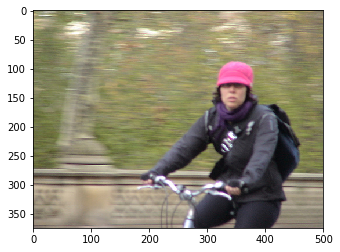

Candidate:  man in black shirt is riding bicycle down the street 
Reference:  woman in pink hat and navy blue coat riding bicycle
Reference:  woman wearing pink cap riding bicycle
Reference:  woman wearing black clothes purple scarf and pink hat is riding bike
Reference:  woman with glasses and pink hat rides her bike
Reference:  the woman is wearing pink hat and is riding bike in the park
Bleu_1 score:  0.6
Bleu_2 score:  0.36514837167011066
Bleu_3 score:  2.764935154957498e-93
Bleu_4 score:  9.013778876140909e-155


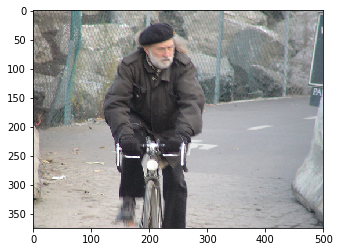

Candidate:  man in black shirt is riding bicycle down the street 
Reference:  man in beret rides bicycle down the street
Reference:  man wearing beret rides his bicycle on recreation trail
Reference:  an old man with grey beard riding his bike
Reference:  closeup of man cycling down road lined with boulders
Reference:  man wearing beret riding bicycle
Bleu_1 score:  0.7
Bleu_2 score:  0.6236095644623235
Bleu_3 score:  0.4969694165039858
Bleu_4 score:  0.34329452398451965


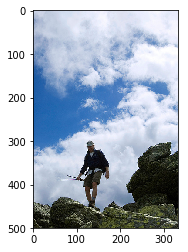

Candidate:  man in red shirt is climbing rock face 
Reference:  hiker makes his way downhill
Reference:  man carying sticks descends rocky hill
Reference:  man is hiking on mountaintop on cloudy day
Reference:  hiker walking along high rocks in front of blue sky with puffy white clouds
Reference:  the man in blue sweater is climbing down the rocks
Bleu_1 score:  0.5
Bleu_2 score:  0.3779644730092272
Bleu_3 score:  2.822759758184417e-93
Bleu_4 score:  9.170599044431425e-155


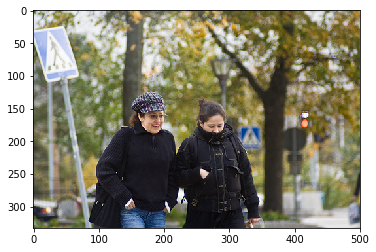

Candidate:  man in black shirt is sitting on the street 
Reference:  two ladies walking on the sidewalk talking to each other
Reference:  two women are bundled up walking through town
Reference:  two women crossing the street on cold day
Reference:  two women walking down the street
Reference:  two women walking near some trees in warm darkcolored garments one with hat one with an upraised collar
Bleu_1 score:  0.4444444444444444
Bleu_2 score:  0.33333333333333337
Bleu_3 score:  2.6177645164606753e-93
Bleu_4 score:  8.612150057732663e-155


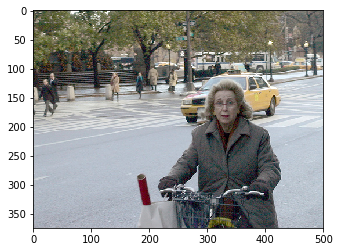

Candidate:  man in black shirt is sitting on the sidewalk 
Reference:  an elderly woman is riding bicycle in the city as yellow taxi is about to pass by
Reference:  an elderly woman rides bicycle along city street
Reference:  an older woman with blond hair rides bicycle down the street
Reference:  woman in grey overcoat rides her bicycle along street
Reference:  older woman wearing glassses riding bicycle with shopping bag on the handle yellow car is in the background
Bleu_1 score:  0.4444444444444444
Bleu_2 score:  0.23570226039551587
Bleu_3 score:  2.1262855015914924e-93
Bleu_4 score:  7.241926111174567e-155


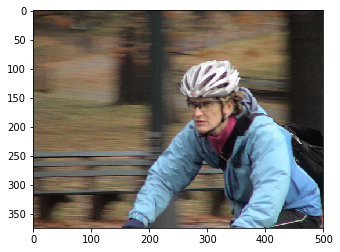

Candidate:  man in black shirt is riding bicycle down the street 
Reference:  person in blue jacket wearing bicycle helmet is riding bike
Reference:  woman is riding her bicycle
Reference:  woman riding bike in park
Reference:  woman with blue jacket wears helmet as she rides bike
Reference:  woman with helmet riding bike
Bleu_1 score:  0.4
Bleu_2 score:  0.21081851067789192
Bleu_3 score:  1.9886052149911737e-93
Bleu_4 score:  6.8489908526642754e-155


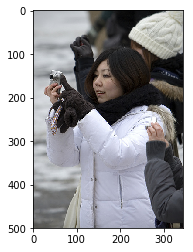

Candidate:  man in black shirt is sitting on the street 
Reference:  girl in white coat takes pictures
Reference:  girl in white puffy jacket takes picture
Reference:  group of people looking into their cameras
Reference:  asian woman in white coat takes photo
Reference:  the woman in the white coat is holding camera in her hand
Bleu_1 score:  0.3333333333333333
Bleu_2 score:  8.612150057732663e-155
Bleu_3 score:  1.8419179593432007e-185
Bleu_4 score:  1.384292958842266e-231


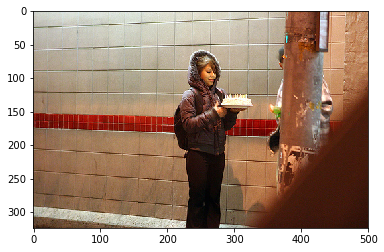

Candidate:  man in black shirt is sitting on the sidewalk 
Reference:  girl in hooded jacket presents cake with candles
Reference:  girl in hood jacket holds birthday cake with many candles
Reference:  girl in winter coat with birthday cake
Reference:  girl is holding birthday cake
Reference:  young girl holding cake with candles dressed in heavy coat
Bleu_1 score:  0.2222222222222222
Bleu_2 score:  7.031791076575252e-155
Bleu_3 score:  1.6309584783156364e-185
Bleu_4 score:  1.2508498911928379e-231


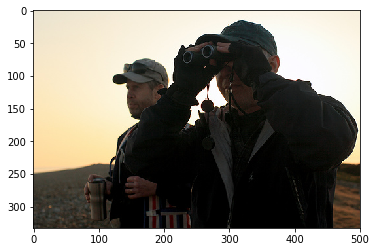

Candidate:  man in black shirt is standing next to the water 
Reference:  man looks through his binoculars while another man holds drink
Reference:  man with thermos is standing next to man who is gazing through binoculars
Reference:  two men are standing together while one looks through binoculars
Reference:  two men look out as one is holding binoculars
Reference:  two people standing next to each other with mountains in the distance
Bleu_1 score:  0.7
Bleu_2 score:  0.4830458915396479
Bleu_3 score:  0.4263586105134349
Bleu_4 score:  0.30213753973567675


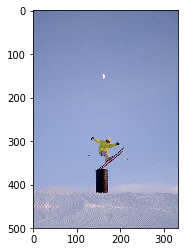

Candidate:  man is doing trick on his bicycle on the edge of bridge 
Reference:  man in yellow jumps with his skis
Reference:  man in yellow ski jumping over barrel
Reference:  man jumps while snow skiing
Reference:  skier catches air over the snow
Reference:  man skiing over barrel in snowy area
Bleu_1 score:  0.25
Bleu_2 score:  7.458340731200295e-155
Bleu_3 score:  1.6896185209462903e-185
Bleu_4 score:  1.2882297539194154e-231


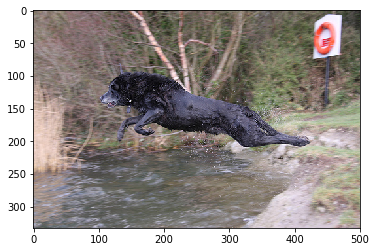

Candidate:  black dog is running through water 
Reference:  black dog is leaping into creek
Reference:  black dog is leaping over stream of running water
Reference:  black dog jumping off river bank near wooded area
Reference:  wet black dog jumping into lake
Reference:  wet black dog leaps across stream
Bleu_1 score:  0.8333333333333334
Bleu_2 score:  0.5773502691896258
Bleu_3 score:  0.4745102806263551
Bleu_4 score:  6.562069055463047e-78


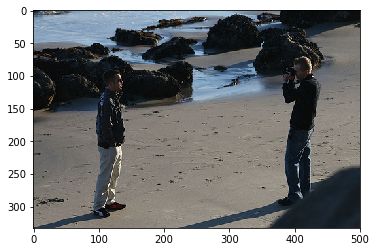

Candidate:  man is walking on the beach 
Reference:  man on the beach is taking picture of another man
Reference:  man posing for his photo on rocky beach
Reference:  man takes picture of another man at the beach
Reference:  man filiming man with sunglasses at the beach
Reference:  two men are standing on rocky shore while one photographs the other
Bleu_1 score:  0.5971094254781577
Bleu_2 score:  0.41368954504257266
Bleu_3 score:  0.3400014732579387
Bleu_4 score:  4.701927940386645e-78


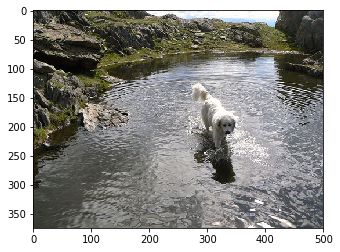

Candidate:  dog runs through the water 
Reference:  dog in some water enclosed by rocky ledge
Reference:  white dog is standing in pond
Reference:  white dog is walking through river that runs through rocky landscape
Reference:  white dog walks through shallow water in the wilderness
Reference:  the white dog is wading in the pond atop the mountain
Bleu_1 score:  0.8187307530779819
Bleu_2 score:  0.40936537653899097
Bleu_3 score:  2.7335463088293394e-93
Bleu_4 score:  8.635715405417689e-155


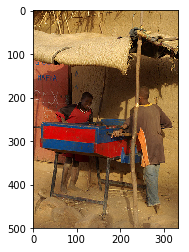

Candidate:  man is sitting on bench with his arms out 
Reference:  two children standing under an awning
Reference:  two kids are playing game of foosball
Reference:  two kids in developing nation are playing table top game under an awning made from burlap
Reference:  two men play game beneath shade
Reference:  two young kids are in hut
Bleu_1 score:  0
Bleu_2 score:  0
Bleu_3 score:  0
Bleu_4 score:  0


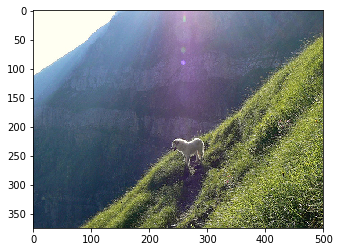

Candidate:  man is walking through the mountains 
Reference:  dog on green hillside
Reference:  dog standing on the side of mountain
Reference:  dog stands on the side of grassy cliff
Reference:  fluffy white dog looks down steep grassy embankment
Reference:  white dog is standing on grassy hillside
Bleu_1 score:  0.28216057496353797
Bleu_2 score:  7.2900276358863456e-155
Bleu_3 score:  1.5591498913318325e-185
Bleu_4 score:  1.171778691554733e-231


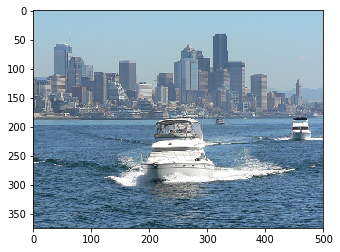

Candidate:  two people are sitting on the beach near the ocean 
Reference:  few boats ride in the water in front of city skyline
Reference:  large boat drives through the harbor
Reference:  white boat is cruising near large city backdrop
Reference:  small yachts in harbor city in background
Reference:  there is white boat in the bay with city in the background
Bleu_1 score:  0.27145122541078787
Bleu_2 score:  7.392705315031213e-155
Bleu_3 score:  1.614780837678646e-185
Bleu_4 score:  1.2199981975731961e-231


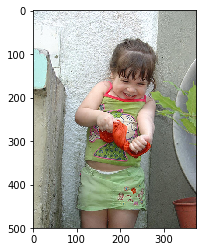

Candidate:  young boy in pink shirt is playing on bed 
Reference:  girl wrings out wet shirt
Reference:  girl wearing green twists something in her hands
Reference:  little girl in green outfit wringing out an orange rag
Reference:  young girl plays outside
Reference:  the little girl in the green outfit is playing with piece of orange material
Bleu_1 score:  0.5555555555555556
Bleu_2 score:  0.26352313834736496
Bleu_3 score:  2.2734980277612576e-93
Bleu_4 score:  7.657404561915943e-155


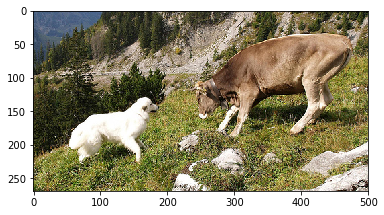

Candidate:  two dogs play together 
Reference:  dog and cow are on rocky slope
Reference:  dog and cow are standing on hillside
Reference:  white dog looks at nervous cow in mountain setting
Reference:  white dog stands in front of cow that has its head down and horns directed at the dog
Reference:  two dogs are in grassy area
Bleu_1 score:  0.3032653298563167
Bleu_2 score:  0.24761510494160163
Bleu_3 score:  1.793125610102159e-93
Bleu_4 score:  5.780789590099596e-155


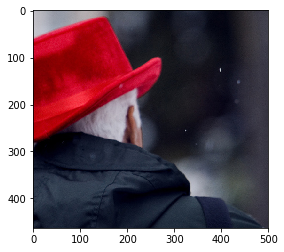

Candidate:  young boy is sitting on the bed 
Reference:  an older man with white hair blue jacket and bright red hat
Reference:  an old man wearing red hat and black raincoat
Reference:  an old man with white hair in red hat
Reference:  person is red hat and winter jacket is looking into the distance
Reference:  person with gray hair wears red hat and watches it snow
Bleu_1 score:  0.21470779802151024
Bleu_2 score:  5.991755122558557e-155
Bleu_3 score:  1.3216063232004422e-185
Bleu_4 score:  1.0009379942300742e-231


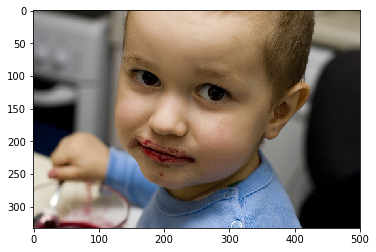

Candidate:  young boy in pretend bed 
Reference:  baby eats and has food on his face
Reference:  boy with lips messy from eating fruit
Reference:  little boy is eating something and got it all over his mouth
Reference:  small child with berries all over its mouth
Reference:  young brown eyed boy with red syrup on his lips is pouring syrup
Bleu_1 score:  0.26812801841425576
Bleu_2 score:  6.3238916243951906e-155
Bleu_3 score:  1.3040878944832891e-185
Bleu_4 score:  9.711929667259895e-232


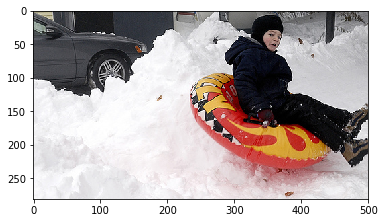

Candidate:  man in red shirt is climbing rock face 
Reference:  boy in black winter clothes sits on an inflated sled by mound of snow
Reference:  child rides down the snow in tube
Reference:  the kid is on float in the snow
Reference:  there is person sitting on plastic blowup float in the high piled snow
Reference:  this person bundled up for the snow slides down the hill on an intertube
Bleu_1 score:  0.25
Bleu_2 score:  7.458340731200295e-155
Bleu_3 score:  1.6896185209462903e-185
Bleu_4 score:  1.2882297539194154e-231


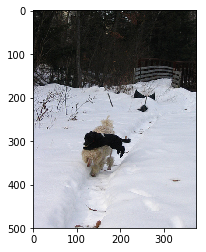

Candidate:  dog is running through the snow 
Reference:  black and white dog playing in the snow together
Reference:  black poodle jumping on the head of white poodle while walking in the snow
Reference:  black dog jumping over white dog in snowy path
Reference:  two dogs playing in the snow
Reference:  two poodles are running through the snow
Bleu_1 score:  0.8333333333333334
Bleu_2 score:  0.7071067811865476
Bleu_3 score:  0.6597539553864471
Bleu_4 score:  0.537284965911771


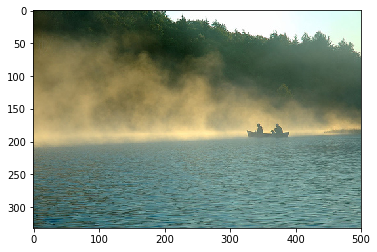

Candidate:  two people are sitting on the beach near the ocean 
Reference:  boat with two fishermen sits peacefully on the lake
Reference:  silhouette of two men in boat on misty lake
Reference:  two men in fishing boat on river enjoy pleasant morning
Reference:  two people are in canoe on river in misty conditions
Reference:  two people drift in small boat on foggy lake with trees in the background
Bleu_1 score:  0.5
Bleu_2 score:  0.408248290463863
Bleu_3 score:  0.3130600345147708
Bleu_4 score:  4.640083527732319e-78


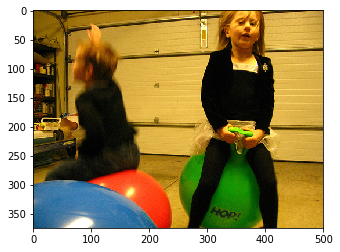

Candidate:  two girls in red dresses are sitting on bed 
Reference:  boy and girl bouncing on ball
Reference:  the children are wearing black tights while hopping
Reference:  two children dressed in black bounce on red and green bouncy balls in garage
Reference:  two kids are bouncing on colorful balls
Reference:  two young children bouncing on balls
Bleu_1 score:  0.5555555555555556
Bleu_2 score:  1.1118237916213198e-154
Bleu_3 score:  2.1469647168628402e-185
Bleu_4 score:  1.5728604687011317e-231


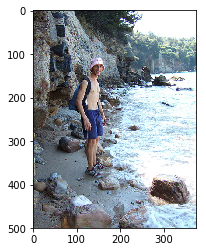

Candidate:  two girls are playing in the water 
Reference:  man stands at the edge of the water near the rocks
Reference:  shirtless man in pink hat is standing on rocky shore
Reference:  shirtless man in pink hat stands on rocky shore
Reference:  shirtless man with backpack and hat is standing on rocky shoreline
Reference:  the man in shorts and hat is standing in the bay beside the ocean
Bleu_1 score:  0.32206169703226534
Bleu_2 score:  0.284031719055601
Bleu_3 score:  2.121239862082274e-93
Bleu_4 score:  6.89149694578813e-155


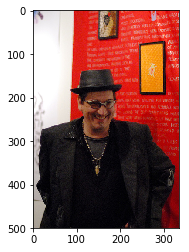

Candidate:  man in black shirt is sitting on the street 
Reference:  man dressed in black wearing hat and glasses in front of red wall
Reference:  man in black hat stands in front of red wall
Reference:  man wearing all black and black hat is smiling
Reference:  man with hat glasses jewelry and jacket stands against an orange wall
Reference:  there is man with glasses and hat wearing black suit jacket indoors
Bleu_1 score:  0.4444444444444444
Bleu_2 score:  0.33333333333333337
Bleu_3 score:  0.2885345571906214
Bleu_4 score:  4.335118471269586e-78


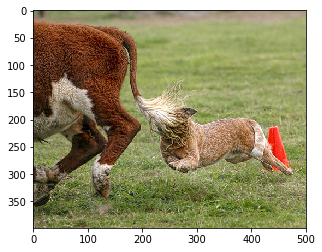

Candidate:  two dogs play together 
Reference:  dog biting the tail of cow
Reference:  dog chasing an animals tail on the grass
Reference:  small animal leaps behind larger animal the larger animal tail obscuring the smaller one face
Reference:  small dog chases after large brown cow
Reference:  tan animal is being swatted in the face by brown and white bull
Bleu_1 score:  0
Bleu_2 score:  0
Bleu_3 score:  0
Bleu_4 score:  0


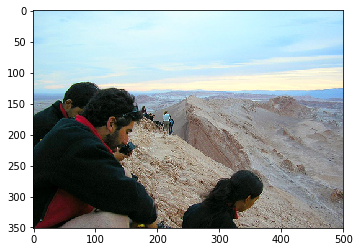

Candidate:  man in black shirt is walking on the edge of the water 
Reference:  few people standing on top of mountain taking pictures
Reference:  group of people peering over the edge of large rocky mountain
Reference:  several people on top of mountain look down at the ground
Reference:  the mountain are light tan in color
Reference:  three people sitting on cliff
Bleu_1 score:  0.4166666666666667
Bleu_2 score:  0.27524094128159016
Bleu_3 score:  0.23111483361241544
Bleu_4 score:  3.603235312613151e-78


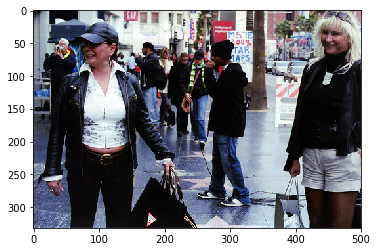

Candidate:  group of people are sitting on the street 
Reference:  city street with two ladies that have shopping bags in their hands with crowd behind them
Reference:  woman in hat holding handbag smiles away from another woman wearing sunglasses and holding shopping bag
Reference:  people are standing on the hollywood walk of fame
Reference:  two older women walking down the busy street with shopping bags
Reference:  two women dressed in leather are standing on city street
Bleu_1 score:  0.6618726769384466
Bleu_2 score:  0.4085166851999189
Bleu_3 score:  2.813289886076841e-93
Bleu_4 score:  8.956404721575399e-155


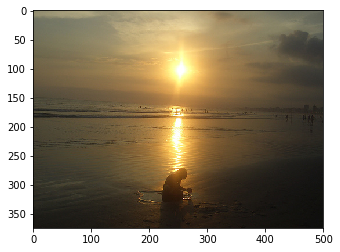

Candidate:  two people are sitting on the beach near the ocean 
Reference:  child playing in the beach sand during sunset
Reference:  child playing in the sand of beach with the sun low on the horizon
Reference:  person on the beach beside the ocean at sunset
Reference:  image of sunset at the beach with kid in the foreground
Reference:  someone paddles small boat across still lake at sunset
Bleu_1 score:  0.5
Bleu_2 score:  0.408248290463863
Bleu_3 score:  0.3130600345147708
Bleu_4 score:  4.640083527732319e-78


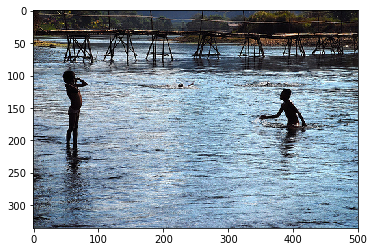

Candidate:  two boys are playing in the water 
Reference:  at least people swim in shallow water that grows deeps towards bridge
Reference:  children are playing and swimming in boy of water with foot bridge in the background
Reference:  kids playing in the water in front of wooden bridge
Reference:  two children playing in lake
Reference:  two children playing in river near wooden bridge
Bleu_1 score:  0.7430381997858699
Bleu_2 score:  0.6552980970848462
Bleu_3 score:  0.5567554974014963
Bleu_4 score:  0.42383656282787796


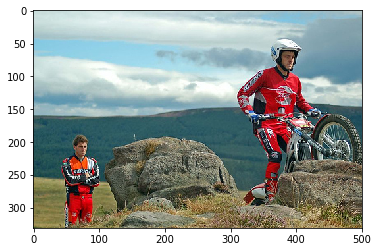

Candidate:  man in red shirt is riding bicycle down the road 
Reference:  dirt biker pushes his motorcycle up rock while another rider watches
Reference:  man in red on dirt bike struggles up rock while another man in red watches
Reference:  man in red pushes his motocross bike up rock
Reference:  man is looking on as another man attempts to climb small boulder with his dirt bike
Reference:  redclad man rides bike through rocky ground while another man looks on
Bleu_1 score:  0.4
Bleu_2 score:  0.2981423969999719
Bleu_3 score:  0.2592550634024553
Bleu_4 score:  3.965294799986402e-78


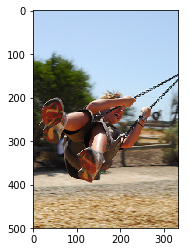

Candidate:  man in white shirt and white shorts is riding horse 
Reference:  lady is swinging and smiling
Reference:  person swinging on swing
Reference:  kid swinging on swing
Reference:  person on swing
Reference:  this girl is having so much fun on the swing
Bleu_1 score:  0.2
Bleu_2 score:  6.6709427497276e-155
Bleu_3 score:  1.5802130991274054e-185
Bleu_4 score:  1.2183324802375697e-231


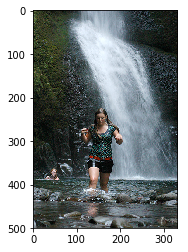

Candidate:  man is standing on the beach by the ocean 
Reference:  an extremely wet woman is wading in front of waterfall
Reference:  woman dressed in shorts and tshirt walking in shallow water in front of waterfall
Reference:  woman wading through pool in front of waterfall
Reference:  the lady is walking through the water
Reference:  wet woman walking through water near large waterfall
Bleu_1 score:  0.3333333333333333
Bleu_2 score:  8.612150057732663e-155
Bleu_3 score:  1.8419179593432007e-185
Bleu_4 score:  1.384292958842266e-231


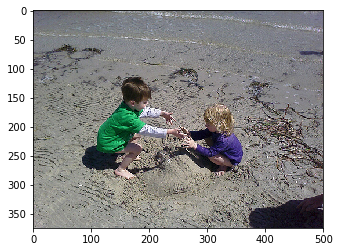

Candidate:  young boy in pink shirt is jumping into the air 
Reference:  little girl and boy play in the sand on the beach
Reference:  young boy and girl play together in the sand
Reference:  boy and girl make sand castle
Reference:  two children build sand castle on the beach
Reference:  two kids building sand castle
Bleu_1 score:  0.4
Bleu_2 score:  0.21081851067789192
Bleu_3 score:  1.9886052149911737e-93
Bleu_4 score:  6.8489908526642754e-155


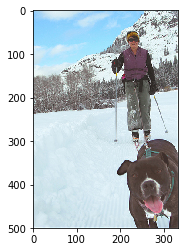

Candidate:  the man is walking through the snow 
Reference:  person is skijoring with dog in the mountains
Reference:  person skis with their dog
Reference:  woman crosscountry skiing with brown dog
Reference:  woman skiing down snowy mountain with brown dog on lesh running with her
Reference:  the brown dog pulls skier across snowcovered ground
Bleu_1 score:  0.2857142857142857
Bleu_2 score:  7.973301625706314e-155
Bleu_3 score:  1.7586776545063733e-185
Bleu_4 score:  1.331960397810445e-231


KeyboardInterrupt: 

In [110]:
for key, desc_list in test_descriptions.items():
    candidate = generate_desc(model, tokenizer, test_features[key], max_length)
    references = [d.split() for d in desc_list]
    images = '../../datasets/flickr8k/Flicker8k_Dataset/'
    plot_image(images + key + ".jpg")
    print("Candidate: ", candidate[9:-6])
    print_references(references)
    calculate_bleu_score(references,candidate.split())
